In [1]:
import os, sys
import random, math
import pickle
import gym
import scipy.integrate as integrate
import random
import numpy as np
import warnings
import torch
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import json
import numpy as np
import scipy as sp
import scipy.stats as st
from datetime import datetime
from copy import deepcopy
from collections import defaultdict
from itertools import product
from copy import deepcopy
from torch import nn 
from gym.utils import seeding
from scipy.stats import multivariate_normal
from sklearn import linear_model
from sklearn.exceptions import ConvergenceWarning
import statsmodels.api as sm
from matplotlib.colors import LogNorm
from tqdm.notebook import tqdm_notebook as tqdm

warnings.filterwarnings('ignore')
sns.set_style("whitegrid")
sns.set_palette("colorblind")
palette = sns.color_palette()
figsize = (15,8)
legend_fontsize = 16

from matplotlib import rc
rc('font',**{'family':'sans-serif'})
rc('figure', **{'dpi': 300})

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


Возьмем немного готового кода Environment, отрисовки

In [2]:
N_ROWS = 3
N_COLS = 3
N_WIN = 3



class TicTacToe(gym.Env):
    def __init__(self, n_rows=N_ROWS, n_cols=N_COLS, n_win=N_WIN):
        self.n_rows = n_rows
        self.n_cols = n_cols
        self.n_win = n_win

        self.board = np.zeros((self.n_rows, self.n_cols), dtype=int)
        self.gameOver = False
        self.boardHash = None
        
        self.curTurn = 1
        self.emptySpaces = None
        
        self.prev_naughts_state = None
        self.prev_naughts_action = None
        self.prev_crosses_state = None
        self.prev_crosses_action = None

        
        self.reset()
        self.seed()
        
    def seed(self, seed=None):
        self.np_random, seed = seeding.np_random(seed)
        return [seed]
        
    def getTotalNumberOfActions(self):
        return self.n_rows * self.n_cols

    def getEmptySpaces(self):
        if self.emptySpaces is None:
            res = np.where(self.board == 0)
            self.emptySpaces = np.array([ (i, j) for i,j in zip(res[0], res[1]) ])
        return self.emptySpaces
    
    def getEmptyInts(self):
        spaces = self.getEmptySpaces()
        return np.array([self.int_from_action(a) for a in spaces], dtype=int)

    def makeMove(self, player, i, j):
        self.board[i, j] = player
        self.emptySpaces = None
        self.boardHash = None

    def getHash(self):
        if self.boardHash is None:
            self.boardHash = ''.join(['%s' % (x+1) for x in self.board.reshape(self.n_rows * self.n_cols)])
        return self.boardHash

    def isTerminal(self):
        # проверим, не закончилась ли игра
        cur_marks, cur_p = np.where(self.board == self.curTurn), self.curTurn
        for i,j in zip(cur_marks[0], cur_marks[1]):
#             print((i,j))
            win = False
            if i <= self.n_rows - self.n_win:
                if np.all(self.board[i:i+self.n_win, j] == cur_p):
                    win = True
            if not win:
                if j <= self.n_cols - self.n_win:
                    if np.all(self.board[i,j:j+self.n_win] == cur_p):
                        win = True
            if not win:
                if i <= self.n_rows - self.n_win and j <= self.n_cols - self.n_win:
                    if np.all(np.array([ self.board[i+k,j+k] == cur_p for k in range(self.n_win) ])):
                        win = True
            if not win:
                if i <= self.n_rows - self.n_win and j >= self.n_win-1:
                    if np.all(np.array([ self.board[i+k,j-k] == cur_p for k in range(self.n_win) ])):
                        win = True
            if win:
                self.gameOver = True
                return self.curTurn

        if len(self.getEmptySpaces()) == 0:
            self.gameOver = True
            return 0

        self.gameOver = False
        return None

    def printBoard(self):
        for i in range(0, self.n_rows):
            print('----'*(self.n_cols)+'-')
            out = '| '
            for j in range(0, self.n_cols):
                if self.board[i, j] == 1:
                    token = 'x'
                if self.board[i, j] == -1:
                    token = 'o'
                if self.board[i, j] == 0:
                    token = ' '
                out += token + ' | '
            print(out)
        print('----'*(self.n_cols)+'-')

    def getState(self):
        return (self.getHash(), self.curTurn)

    def action_from_int(self, action_int):
        return ( int(action_int / self.n_cols), int(action_int % self.n_cols))

    def int_from_action(self, action):
        return action[0] * self.n_cols + action[1]
    
    def randomIntAction(self):
        empty_spaces = self.getEmptySpaces()
        selected_action = self.np_random.randint(len(empty_spaces), size=1)[0]
        return self.int_from_action(empty_spaces[selected_action])
    
    def randomAction(self):
        empty_spaces = self.getEmptySpaces()
        selected_action = self.np_random.randint(len(empty_spaces), size=1)[0]
        return empty_spaces[selected_action]
    
    def step_int(self, intAction):
        action = self.action_from_int(intAction)
        return self.step(action)
    
    def step(self, action):
        if self.curTurn > 0:
            # Crosses
            self.prev_crosses_state = self.getState()[0]
            self.prev_crosses_action = self.int_from_action(action)
        else:
            # Naughts
            self.prev_naughts_state = self.getState()[0]
            self.prev_naughts_action = self.int_from_action(action)
        
        if self.board[action[0], action[1]] != 0:
            return self.getState(), -10, True, {}
        self.makeMove(self.curTurn, action[0], action[1])
        reward = self.isTerminal()
        self.curTurn = -self.curTurn
        return self.getState(), 0 if reward is None else reward, reward is not None, {}

    def reset(self):
        self.board = np.zeros((self.n_rows, self.n_cols), dtype=int)
        self.boardHash = None
        self.gameOver = False
        self.emptySpaces = None
        self.curTurn = 1
        
        self.prev_crosses_state = None
        self.prev_crosses_action = None
        self.prev_naughts_state = None
        self.prev_naughts_action = None
        
        return self.getState()
        
        
def plot_board(env, pi, showtext=True, verbose=True, fontq=20, fontx=60):
    '''Рисуем доску с оценками из стратегии pi'''
    fig, ax = plt.subplots(1, 1, figsize=(8, 8))
    X, Y = np.meshgrid(np.arange(0, env.n_rows), np.arange(0, env.n_rows))
    Z = np.zeros((env.n_rows, env.n_cols)) + .01
    s, actions = env.getHash(), env.getEmptySpaces()
    if pi is not None and s in pi.Q:
        for i, a in enumerate(actions):
            Z[a[0], a[1]] = pi.Q[s][i]
    ax.set_xticks([])
    ax.set_yticks([])
    surf = ax.imshow(Z, cmap=plt.get_cmap('Accent', 10), vmin=-1, vmax=1)
    if showtext:
        for i,a in enumerate(actions):
            if pi is not None and s in pi.Q:
                ax.text( a[1] , a[0] , "%.3f" % pi.Q[s][i], fontsize=fontq, horizontalalignment='center', verticalalignment='center', color="w" )
#             else:
#                 ax.text( a[1] , a[0] , "???", fontsize=fontq, horizontalalignment='center', verticalalignment='center', color="w" )
    for i in range(env.n_rows):
        for j in range(env.n_cols):
            if env.board[i, j] == -1:
                ax.text(j, i, "O", fontsize=fontx, horizontalalignment='center', verticalalignment='center', color="w" )
            if env.board[i, j] == 1:
                ax.text(j, i, "X", fontsize=fontx, horizontalalignment='center', verticalalignment='center', color="w" )
    cbar = plt.colorbar(surf, ticks=[0, 1])
    ax.grid(False)
    plt.show()

    
def get_and_print_move(env, pi, s, actions, random=False, verbose=True, fontq=20, fontx=60):
    '''Делаем ход, рисуем доску'''
    plot_board(env, pi, fontq=fontq, fontx=fontx)
    if verbose and (pi is not None):
        if s in pi.Q:
            for i,a in enumerate(actions):
                print(i, a, pi.Q[s][i])
        else:
            print("Стратегия не знает, что делать...")
    if random:
        return np.random.randint(len(actions))
    else:
        return pi.getActionGreedy(s, len(actions))
    
    
def plot_test_game(env, pi1, pi2, random_crosses=False, random_naughts=True, verbose=True, fontq=20, fontx=60):
    '''Играем тестовую партию между стратегиями или со случайными ходами, рисуем ход игры'''
    done = False
    env.reset()
    while not done:
        s, actions = env.getHash(), env.getEmptySpaces()
        if env.curTurn == 1:
            a = get_and_print_move(env, pi1, s, actions, random=random_crosses, verbose=verbose, fontq=fontq, fontx=fontx)
        else:
            a = get_and_print_move(env, pi2, s, actions, random=random_naughts, verbose=verbose, fontq=fontq, fontx=fontx)
        observation, reward, done, info = env.step(actions[a])
        if reward == 1:
            print("Крестики выиграли!")
            plot_board(env, None, showtext=False, fontq=fontq, fontx=fontx)
        if reward == -1:
            print("Нолики выиграли!")
            plot_board(env, None, showtext=False, fontq=fontq, fontx=fontx)


# Advanced DL and RL: Домашнее задание 2

Второе домашнее задание опять посвящено игре; его базовая часть, надеюсь, не слишком большая, но я добавил опциональную часть, которая, думаю, должна быть достаточно интересной для любого слушателя. Как обычно, **в качестве решения ожидается ссылка на jupyter-ноутбук на вашем github (или публичный, или с доступом для snikolenko); ссылку обязательно нужно прислать в виде сданного домашнего задания на портале Академии.** Любые комментарии, новые идеи и рассуждения на тему, как всегда, категорически приветствуются.

### Из предыдущего задания

In [3]:
def maxof(x):
    m = np.max(x)
    return 0.0 if np.isneginf(m) else m

def valueof(x):
    return 0.0 if np.isneginf(x) else x

* Функция, которая вернет нам следующее **жадное** действие в состоянии $state$ при политике $Q$
* Стратегия, которая случайным образом выбирает действие


In [1]:
def action_q(state, Q):
    return np.argmax(Q[state])

def policy_random():
    def strategy(env):
        return env.randomIntAction()
    return strategy

**Стратегия**, которая действует по обученной политике $Q$

In [5]:
def policy_q(Q, eps=0.0):
    def strategy(env):
        state = env.getState()
        if (random.random() <= eps) or \
          (state not in Q) or ((state in Q) and (np.all(Q[state] == -np.inf))):
            return env.randomIntAction()
        return action_q(state, Q)
    return strategy

In [6]:
def tic_tac_toe_episode(
      policy_crosses, 
      policy_naughts, 
      env=TicTacToe(n_rows=3, n_cols=3, n_win=3), 
      random_state=None, 
      verbose=False
    ):
    rewards_crosses, actions_crosses, states_crosses = [], [], []
    rewards_naughts, actions_naughts, states_naughts = [], [], []
    
    if random_state:
        random.seed(random_state)
        env.seed(random_state)
    state = env.reset()
        
    i = -1
    while True:
        i += 1
        
        if (i % 2 != 0):
            states_naughts.append(state)
            action = policy_naughts(env)
            actions_naughts.append(action)
            state, reward, done, _ = env.step_int(action)
            rewards_naughts.append(reward)
        else:
            states_crosses.append(state)
            action = policy_crosses(env)
            actions_crosses.append(action)
            state, reward, done, _ = env.step_int(action)
            rewards_crosses.append(reward)
            
        if verbose:
            env.printBoard()
            
        if done == True:
            if not np.isclose(reward, 0.0, atol=1e-4, rtol=0.0):
                if (i % 2 == 0):
                    rewards_naughts[-1] = -reward
                else:
                    rewards_crosses[-1] = reward
                    rewards_naughts[-1] = -reward
            break
                    
    return (
        states_crosses,
        actions_crosses,
        rewards_crosses
    ), (
        states_naughts,
        actions_naughts,
        rewards_naughts
    )
  

In [ ]:
policy_crosses = policy_random()
policy_naughts = policy_random()


tic_tac_toe_episode(
    policy_crosses, 
    policy_naughts, 
    random_state=100500,
    verbose=True
)

-------------
|   |   | x | 
-------------
|   |   |   | 
-------------
|   |   |   | 
-------------
-------------
|   |   | x | 
-------------
| o |   |   | 
-------------
|   |   |   | 
-------------
-------------
|   | x | x | 
-------------
| o |   |   | 
-------------
|   |   |   | 
-------------
-------------
|   | x | x | 
-------------
| o |   | o | 
-------------
|   |   |   | 
-------------
-------------
|   | x | x | 
-------------
| o | x | o | 
-------------
|   |   |   | 
-------------
-------------
|   | x | x | 
-------------
| o | x | o | 
-------------
|   | o |   | 
-------------
-------------
|   | x | x | 
-------------
| o | x | o | 
-------------
|   | o | x | 
-------------
-------------
| o | x | x | 
-------------
| o | x | o | 
-------------
|   | o | x | 
-------------
-------------
| o | x | x | 
-------------
| o | x | o | 
-------------
| x | o | x | 
-------------


(([('111111111', 1),
   ('112011111', 1),
   ('122010111', 1),
   ('122020101', 1),
   ('022020102', 1)],
  [2, 1, 4, 8, 6],
  [0, 0, 0, 0, 1]),
 ([('112111111', -1), ('122011111', -1), ('122020111', -1), ('122020102', -1)],
  [3, 5, 7, 0],
  [0, 0, 0, -1]))

Расчет средней награды от игры с использованием имеющейся функции политики

In [7]:
def calculate_reward_by_policies(
      policy_crosses,
      policy_naughts, 
      env=TicTacToe(n_rows=3, n_cols=3, n_win=3),
      num_experiments=1_000, 
      random_state=None
    ):
    if random_state:
        random.seed(random_state)
        env.seed(random_state)

    reward_c, reward_n = 0.0, 0.0
    for _ in tqdm(range(num_experiments)):
        (states_c, actions_c, rewards_c), (states_n, actions_n, rewards_n) = \
              tic_tac_toe_episode(policy_crosses, policy_naughts, env)
        reward_c += rewards_c[-1]
        reward_n += rewards_n[-1]
    return (
        reward_c / num_experiments,
        reward_n / num_experiments
    )


In [ ]:
policy_crosses = policy_random()
policy_naughts = policy_random()
print(calculate_reward_by_policies(policy_crosses, policy_naughts, num_experiments=10000))

  0%|          | 0/10000 [00:00<?, ?it/s]

(0.2931, -0.2931)


Cтратегия работы с $\epsilon$

In [2]:
def eps_decay_delayed(eps_start=1.0, eps_min=0.01, decay=0.99999, delay=100_000):
    epsilon = eps_start
    for _ in range(delay):
        yield epsilon
    while True:
        epsilon = max(eps_min, epsilon * decay)
        yield epsilon


def eps_decay(eps_start=1.0, eps_min=0.01, decay=0.99999):
    epsilon = eps_start
    yield epsilon
    while True:
        epsilon = max(eps_min, epsilon * decay)
        yield epsilon


def eps_constant(epsilon=1.0):
    while True:
        yield epsilon

## Часть первая: крестики-нолики при помощи Q-обучения

### 1. Реализуйте обычное (табличное) Q-обучение. Обучите стратегии крестиков и ноликов для доски 3х3.

* Обучаем две отдельные стратегии - одну для крестиков, другую - для ноликов. 
* В процессе обучения эти стратегии учатся играть со случайным противником.
* Фиксировал большой exploration - $0.85$ - мне кажется, этого должно быть достаточно, чтобы много заниматься exploration, но в то же время прослеживалась какая-то основная стратегия игры.

In [9]:
def q_learning(
      eps_generator,
      env=TicTacToe(n_rows=3, n_cols=3, n_win=3),
      num_experiments=10000, 
      random_state=None, 
      gamma=1.0, 
      alpha=0.01, 
      score_every=0.1, 
      score_func=None, 
      verbose=False
    ):

    if random_state:
        random.seed(random_state)
        env.seed(random_state)

    space_n = env.getTotalNumberOfActions()
    Q_c = defaultdict(lambda: np.full(space_n, -np.inf))
    Q_n = defaultdict(lambda: np.full(space_n, -np.inf))
    scores = []
        
    for i in tqdm(range(num_experiments)):
        # текущий eps
        eps = next(eps_generator)
        
        ####### Обучаем стратегию для крестиков #######
        
        policy_crosses = policy_q(Q_c, eps)  # стратегия для крестиков
        policy_naughts = policy_random()  # стратегия для ноликов
        
        (states_c, actions_c, rewards_c), _ = tic_tac_toe_episode(
            policy_crosses,
            policy_naughts, 
            env
        )

        # Обрабатываем стратегию крестиков - последний опыт
        v_c = valueof(Q_c[states_c[-1]][actions_c[-1]])
        mult = (rewards_c[-1] - gamma * maxof(Q_c[states_c[-1]]))
        Q_c[states_c[-1]][actions_c[-1]] = v_c + alpha * mult
        
        # Итерируемся по опыту
        for Sc, Ac, Rc, Sn, An in zip(states_c[-2::-1], actions_c[-2::-1], 
                                      rewards_c[-2::-1], states_c[::-1], 
                                      actions_c[::-1]):
            v_c = valueof(Q_c[Sc][Ac])
            Q_c[Sc][Ac] = v_c + alpha * (Rc + gamma * maxof(Q_c[Sn]) - v_c)
            
        ######## Обучаем стратегию для ноликов ########
        
        # стратегия крестиков
        policy_crosses = policy_random()
        
        # стратегя ноликов
        policy_naughts = policy_q(Q_n, eps)
        
        _, (states_n, actions_n, rewards_n) = tic_tac_toe_episode(
            policy_crosses, 
            policy_naughts, 
            env
        )

        # Обрабатываем стратегию ноликов - последний опыт
        v_n = valueof(Q_n[states_n[-1]][actions_n[-1]])
        mult = (rewards_n[-1] - gamma * maxof(Q_n[states_n[-1]]))
        Q_n[states_n[-1]][actions_n[-1]] = v_n + alpha * mult
        # Итерируемся по опыту
        for Sc, Ac, Rc, Sn, An in zip(states_n[-2::-1], 
                                      actions_n[-2::-1], 
                                      rewards_n[-2::-1], 
                                      states_n[::-1], 
                                      actions_n[::-1]):
            v_n = valueof(Q_n[Sc][Ac])
            Q_n[Sc][Ac] = v_n + alpha * (Rc + gamma * maxof(Q_n[Sn]) - v_n)
            
        # скоринг 
        if ((i + 1) % int(num_experiments * score_every)) == 0:
            if not (score_func is None):
                random_state = random.getstate()

                # друг против друга
                score, _ = score_func(policy_q(deepcopy(Q_c), 0.0), 
                                      policy_q(deepcopy(Q_n), 0.0), 
                                      env=env)
                
                # нолики против случайной стратегии крестиков
                _, score_n = score_func(policy_random(), 
                                        policy_q(deepcopy(Q_n), 0.0), 
                                        env=env)
                
                # крестики против случайной стратегии ноликов
                score_c, _ = score_func(policy_q(deepcopy(Q_c), 0.0), 
                                        policy_random(), 
                                        env=env)
                scores.append({
                    'gamma': gamma,
                    'epsilon': eps,
                    'experiment': i + 1,
                    'score_c': score_c,
                    'score_n': score_n,
                    'score': score,
                })
                if verbose:
                    print(f'Score at {i + 1} / {num_experiments} = {scores[-1]["score_c"]}/{scores[-1]["score_n"]}/{scores[-1]["score"]}', flush=True)
                random.setstate(random_state)

    return Q_c, Q_n, scores

In [44]:
Q_c_33, Q_n_33, scores_33 = q_learning(
    eps_constant(1.0),
    num_experiments=1_000,
    random_state=100500,
    gamma=1.0,
    alpha=0.1,
    score_every=0.01,
    score_func=calculate_reward_by_policies,
    verbose=True
)

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 10 / 1000 = 0.214/-0.181/0.387


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 20 / 1000 = 0.363/-0.255/0.455


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 30 / 1000 = 0.207/-0.241/0.23


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 40 / 1000 = 0.161/-0.28/0.174


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 50 / 1000 = 0.144/-0.222/0.267


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 60 / 1000 = 0.227/-0.228/0.347


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 70 / 1000 = 0.247/-0.191/0.38


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 80 / 1000 = 0.276/-0.219/0.124


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 90 / 1000 = 0.225/-0.241/0.143


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 100 / 1000 = 0.244/-0.284/0.221


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 110 / 1000 = 0.275/-0.263/0.176


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 120 / 1000 = 0.418/-0.295/0.426


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 130 / 1000 = 0.477/-0.286/0.404


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 140 / 1000 = 0.241/-0.257/0.501


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 150 / 1000 = 0.433/-0.29/0.411


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 160 / 1000 = 0.246/-0.228/-0.428


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 170 / 1000 = 0.227/-0.241/-0.308


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 180 / 1000 = 0.454/-0.212/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 190 / 1000 = 0.478/-0.185/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 200 / 1000 = 0.451/-0.204/0.641


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 210 / 1000 = 0.45/-0.155/0.621


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 220 / 1000 = 0.473/-0.151/0.606


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 230 / 1000 = 0.436/-0.147/0.633


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 240 / 1000 = 0.454/-0.216/0.671


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 250 / 1000 = 0.479/-0.163/0.613


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 260 / 1000 = 0.458/-0.192/0.587


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 270 / 1000 = 0.418/-0.126/0.864


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 280 / 1000 = 0.407/-0.192/0.832


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 290 / 1000 = 0.471/-0.159/0.848


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 300 / 1000 = 0.42/-0.186/0.844


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 310 / 1000 = 0.434/-0.195/0.8


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 320 / 1000 = 0.446/-0.266/0.816


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 330 / 1000 = 0.38/-0.175/0.862


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 340 / 1000 = 0.428/-0.212/0.836


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 350 / 1000 = 0.451/-0.191/0.854


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 360 / 1000 = 0.454/-0.206/0.82


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 370 / 1000 = 0.445/-0.19/0.8


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 380 / 1000 = 0.442/-0.236/0.808


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 390 / 1000 = 0.45/-0.18/0.852


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 400 / 1000 = 0.457/-0.235/0.846


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 410 / 1000 = 0.442/-0.163/0.824


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 420 / 1000 = 0.457/-0.153/0.81


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 430 / 1000 = 0.453/-0.157/0.816


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 440 / 1000 = 0.468/-0.187/0.842


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 450 / 1000 = 0.405/-0.179/0.866


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 460 / 1000 = 0.401/-0.164/0.862


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 470 / 1000 = 0.431/-0.141/0.86


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 480 / 1000 = 0.405/-0.158/0.81


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 490 / 1000 = 0.434/-0.16/0.832


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 500 / 1000 = 0.453/-0.146/0.856


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 510 / 1000 = 0.46/-0.131/0.826


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 520 / 1000 = 0.452/-0.168/0.824


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 530 / 1000 = 0.402/-0.091/0.848


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 540 / 1000 = 0.414/-0.192/0.82


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 550 / 1000 = 0.444/-0.116/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 560 / 1000 = 0.446/-0.131/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 570 / 1000 = 0.396/-0.181/0.824


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 580 / 1000 = 0.417/-0.115/0.838


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 590 / 1000 = 0.4/-0.102/0.818


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 600 / 1000 = 0.437/-0.07/0.844


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 610 / 1000 = 0.428/-0.091/0.83


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 620 / 1000 = 0.393/-0.093/0.822


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 630 / 1000 = 0.455/-0.099/0.446


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 640 / 1000 = 0.437/-0.058/0.428


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 650 / 1000 = 0.411/-0.065/0.467


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 660 / 1000 = 0.437/-0.072/0.464


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 670 / 1000 = 0.484/-0.026/0.445


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 680 / 1000 = 0.461/0.028/0.318


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 690 / 1000 = 0.464/-0.004/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 700 / 1000 = 0.413/0.032/0.337


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 710 / 1000 = 0.444/0.042/0.35


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 720 / 1000 = 0.692/0.007/0.727


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 730 / 1000 = 0.466/-0.002/0.535


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 740 / 1000 = 0.503/-0.013/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 750 / 1000 = 0.54/0.001/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 760 / 1000 = 0.471/-0.045/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 770 / 1000 = 0.514/0.03/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 780 / 1000 = 0.471/0.026/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 790 / 1000 = 0.488/0.01/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 800 / 1000 = 0.435/0.054/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 810 / 1000 = 0.525/-0.086/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 820 / 1000 = 0.484/-0.017/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 830 / 1000 = 0.717/-0.04/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 840 / 1000 = 0.403/-0.073/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 850 / 1000 = 0.388/-0.005/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 860 / 1000 = 0.434/-0.05/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 870 / 1000 = 0.418/-0.05/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 880 / 1000 = 0.446/-0.072/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 890 / 1000 = 0.759/-0.045/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 900 / 1000 = 0.443/-0.088/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 910 / 1000 = 0.481/-0.054/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 920 / 1000 = 0.442/-0.099/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 930 / 1000 = 0.435/-0.122/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 940 / 1000 = 0.437/-0.067/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 950 / 1000 = 0.758/-0.004/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 960 / 1000 = 0.771/-0.054/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 970 / 1000 = 0.439/-0.031/-0.202


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 980 / 1000 = 0.442/-0.11/-0.218


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 990 / 1000 = 0.389/-0.035/-0.23


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 1000 / 1000 = 0.73/-0.092/1.0


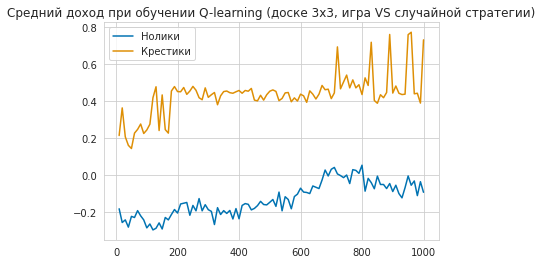

In [ ]:
plt.plot(
    [x['experiment'] for x in scores_33],
    [x['score_n'] for x in scores_33],
    label='Нолики'
)
plt.plot(
    [x['experiment'] for x in scores_33],
    [x['score_c'] for x in scores_33],
    label='Крестики'
)
plt.legend()
plt.title('Средний доход при обучении Q-learning (доске 3x3, игра VS случайной стратегии)')
plt.show()

### Видно, что обе стратегии показывают рост качества в сравнении с игрой со случайной стратегией.

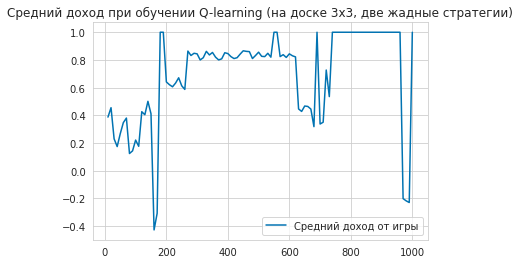

In [ ]:
plt.plot(
    [x['experiment'] for x in scores_33],
    [x['score'] for x in scores_33],
    label='Средний доход от игры'
)

plt.legend()
plt.title('Средний доход при обучении Q-learning (на доске 3x3, две жадные стратегии)')
plt.show()

### Кажется что мало итераций, так как ожидаем что обе жадные стратегии должны чаще сходится к ничьей, но, к сожалению, увеличение числа всех итераций ноутбука даже до 10_000 превышает превышает сессию колаба.

### 2. Попробуйте обучить стратегии крестиков и ноликов для доски 4х4 и/или 5х5.

#### Начнем с доски $4x4$

In [ ]:
Q_c_44, Q_n_44, scores_44 = q_learning(
    eps_constant(1.0),
    env=TicTacToe(n_rows=4, n_cols=4, n_win=4),
    num_experiments=1_000,
    random_state=100500,
    gamma=1.0,
    alpha=0.1,
    score_every=0.01,
    score_func=calculate_reward_by_policies,
    verbose=True
)

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 10 / 1000 = -0.004/-0.018/-0.045


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 20 / 1000 = 0.001/-0.035/0.059


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 30 / 1000 = 0.025/-0.074/0.03


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 40 / 1000 = -0.008/-0.039/-0.04


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 50 / 1000 = 0.089/-0.068/0.132


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 60 / 1000 = -0.009/-0.033/0.024


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 70 / 1000 = 0.027/-0.059/0.022


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 80 / 1000 = -0.04/-0.066/0.011


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 90 / 1000 = 0.021/-0.024/0.026


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 100 / 1000 = 0.125/-0.035/0.145


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 110 / 1000 = 0.109/-0.027/0.09


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 120 / 1000 = 0.035/-0.05/0.014


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 130 / 1000 = 0.004/-0.045/-0.028


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 140 / 1000 = 0.133/-0.024/0.2


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 150 / 1000 = 0.103/-0.038/-0.003


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 160 / 1000 = 0.132/-0.031/-0.013


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 170 / 1000 = 0.047/-0.069/-0.001


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 180 / 1000 = 0.088/-0.036/0.007


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 190 / 1000 = 0.152/-0.028/0.013


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 200 / 1000 = 0.096/-0.057/0.137


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 210 / 1000 = 0.138/-0.005/0.121


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 220 / 1000 = 0.118/-0.009/0.13


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 230 / 1000 = 0.139/-0.076/0.162


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 240 / 1000 = 0.129/-0.042/-0.004


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 250 / 1000 = 0.127/-0.027/0.049


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 260 / 1000 = 0.09/-0.036/0.017


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 270 / 1000 = 0.061/-0.008/0.063


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 280 / 1000 = 0.071/-0.036/0.044


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 290 / 1000 = 0.088/-0.033/0.048


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 300 / 1000 = 0.124/-0.047/0.034


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 310 / 1000 = 0.128/-0.05/0.084


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 320 / 1000 = 0.085/-0.04/0.037


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 330 / 1000 = 0.099/-0.007/0.061


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 340 / 1000 = 0.132/0.004/0.16


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 350 / 1000 = 0.165/-0.068/0.108


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 360 / 1000 = 0.2/-0.012/0.175


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 370 / 1000 = 0.147/-0.038/0.119


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 380 / 1000 = 0.157/-0.058/0.155


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 390 / 1000 = 0.111/-0.048/0.037


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 400 / 1000 = 0.101/-0.04/-0.031


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 410 / 1000 = 0.073/-0.019/0.014


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 420 / 1000 = 0.078/-0.034/0.044


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 430 / 1000 = 0.106/-0.025/0.05


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 440 / 1000 = 0.102/-0.038/0.125


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 450 / 1000 = 0.03/-0.026/-0.053


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 460 / 1000 = 0.044/-0.024/-0.016


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 470 / 1000 = 0.123/-0.058/0.105


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 480 / 1000 = 0.117/-0.044/0.102


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 490 / 1000 = 0.135/-0.076/0.089


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 500 / 1000 = 0.074/-0.038/0.072


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 510 / 1000 = 0.131/-0.048/0.117


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 520 / 1000 = 0.02/-0.017/-0.064


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 530 / 1000 = 0.064/0.004/-0.043


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 540 / 1000 = 0.045/-0.07/-0.059


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 550 / 1000 = 0.064/-0.075/-0.047


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 560 / 1000 = 0.006/0.011/-0.076


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 570 / 1000 = 0.026/-0.031/-0.051


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 580 / 1000 = 0.015/-0.022/-0.011


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 590 / 1000 = 0.079/-0.042/-0.041


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 600 / 1000 = 0.041/-0.041/-0.069


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 610 / 1000 = 0.007/-0.021/-0.035


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 620 / 1000 = 0.029/0.015/-0.072


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 630 / 1000 = 0.052/-0.024/-0.063


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 640 / 1000 = 0.037/-0.037/-0.038


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 650 / 1000 = 0.006/-0.041/-0.069


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 660 / 1000 = 0.031/-0.044/-0.018


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 670 / 1000 = 0.002/-0.018/-0.068


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 680 / 1000 = -0.004/-0.058/-0.054


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 690 / 1000 = 0.005/-0.054/-0.096


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 700 / 1000 = 0.029/-0.077/-0.077


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 710 / 1000 = 0.021/0.012/-0.044


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 720 / 1000 = 0.099/-0.026/-0.133


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 730 / 1000 = 0.005/0.003/-0.068


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 740 / 1000 = 0.002/-0.012/-0.062


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 750 / 1000 = 0.093/-0.021/-0.056


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 760 / 1000 = 0.113/-0.041/-0.115


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 770 / 1000 = 0.106/-0.048/-0.122


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 780 / 1000 = 0.111/-0.029/-0.128


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 790 / 1000 = 0.108/-0.02/-0.129


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 800 / 1000 = 0.14/-0.046/-0.129


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 810 / 1000 = 0.133/-0.085/-0.078


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 820 / 1000 = 0.116/-0.001/-0.12


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 830 / 1000 = 0.094/-0.068/-0.074


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 840 / 1000 = 0.122/-0.048/0.089


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 850 / 1000 = 0.107/-0.069/0.135


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 860 / 1000 = 0.148/-0.026/0.137


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 870 / 1000 = 0.115/-0.056/0.112


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 880 / 1000 = 0.154/-0.055/0.121


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 890 / 1000 = 0.08/-0.012/0.1


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 900 / 1000 = 0.13/-0.034/0.085


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 910 / 1000 = 0.12/-0.053/-0.092


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 920 / 1000 = 0.128/-0.034/0.08


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 930 / 1000 = 0.136/-0.049/0.081


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 940 / 1000 = 0.112/-0.043/0.076


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 950 / 1000 = 0.081/-0.061/0.092


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 960 / 1000 = 0.099/-0.005/0.066


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 970 / 1000 = 0.089/-0.031/0.106


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 980 / 1000 = 0.102/-0.032/-0.096


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 990 / 1000 = 0.111/-0.009/-0.089


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 1000 / 1000 = 0.056/-0.039/0.074


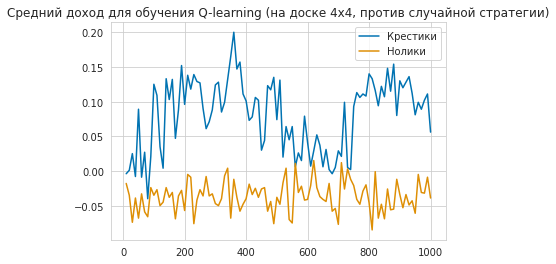

In [ ]:
plt.plot(
    [x['experiment'] for x in scores_44],
    [x['score_c'] for x in scores_44],
    label='Крестики'
)

plt.plot(
    [x['experiment'] for x in scores_44],
    [x['score_n'] for x in scores_44],
    label='Нолики'
)

plt.legend()
plt.title('Средний доход для обучения Q-learning (на доске 4x4, против случайной стратегии)')
plt.show()

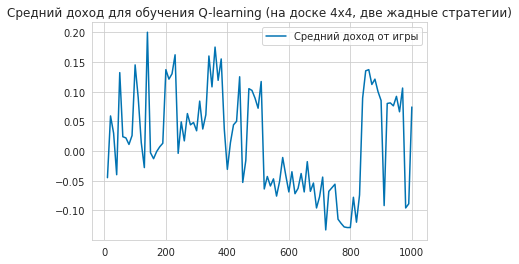

In [ ]:
plt.plot(
    [x['experiment'] for x in scores_44],
    [x['score'] for x in scores_44],
    label='Средний доход от игры'
)

plt.legend()
plt.title('Средний доход для обучения Q-learning (на доске 4x4, две жадные стратегии)')
plt.show()

* Визуально, рост уже не такой уверенный как в случае с игрой на доске $3x3$, но все же виден. 
* в текущей реализации, при обучении, мы много занимаемся exploration, чтобы лучше покрыть пространство событий
* по времени обучение уже занимает больше времени, чем для $3x3$

#### Попробуем на доске $5x5$

In [ ]:
Q_c_55, Q_n_55, scores_55 = q_learning(
    eps_constant(1.0),
    env=TicTacToe(n_rows=5, n_cols=5, n_win=5),
    num_experiments=1_000,
    random_state=100500,
    gamma=1.0,
    alpha=0.1,
    score_every=0.01,
    score_func=calculate_reward_by_policies,
    verbose=True
)

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 10 / 1000 = 0.087/-0.098/0.066


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 20 / 1000 = 0.101/-0.057/0.103


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 30 / 1000 = 0.052/-0.106/0.092


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 40 / 1000 = 0.072/-0.051/0.054


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 50 / 1000 = 0.089/-0.13/0.035


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 60 / 1000 = 0.067/-0.083/0.119


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 70 / 1000 = 0.098/-0.102/0.118


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 80 / 1000 = 0.083/-0.071/0.083


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 90 / 1000 = 0.08/-0.132/0.136


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 100 / 1000 = 0.143/-0.098/0.141


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 110 / 1000 = 0.121/-0.059/0.104


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 120 / 1000 = 0.102/-0.114/0.139


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 130 / 1000 = 0.108/-0.129/0.122


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 140 / 1000 = 0.1/-0.092/0.143


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 150 / 1000 = 0.118/-0.084/0.148


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 160 / 1000 = 0.096/-0.102/0.106


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 170 / 1000 = 0.102/-0.121/0.132


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 180 / 1000 = 0.089/-0.065/0.173


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 190 / 1000 = 0.078/-0.092/0.122


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 200 / 1000 = 0.115/-0.053/0.143


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 210 / 1000 = 0.12/-0.076/0.143


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 220 / 1000 = 0.124/-0.105/0.192


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 230 / 1000 = 0.134/-0.086/0.113


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 240 / 1000 = 0.122/-0.082/0.136


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 250 / 1000 = 0.124/-0.077/0.141


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 260 / 1000 = 0.106/-0.083/0.142


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 270 / 1000 = 0.139/-0.091/0.111


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 280 / 1000 = 0.057/-0.074/0.127


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 290 / 1000 = 0.119/-0.063/0.129


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 300 / 1000 = 0.129/-0.088/0.114


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 310 / 1000 = 0.108/-0.119/0.135


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 320 / 1000 = 0.089/-0.116/0.123


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 330 / 1000 = 0.115/-0.126/0.137


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 340 / 1000 = 0.094/-0.099/0.099


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 350 / 1000 = 0.133/-0.068/0.121


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 360 / 1000 = 0.151/-0.079/0.092


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 370 / 1000 = 0.08/-0.067/0.132


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 380 / 1000 = 0.148/-0.088/0.137


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 390 / 1000 = 0.104/-0.076/0.127


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 400 / 1000 = 0.131/-0.093/0.123


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 410 / 1000 = 0.131/-0.074/0.14


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 420 / 1000 = 0.135/-0.108/0.103


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 430 / 1000 = 0.129/-0.118/0.116


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 440 / 1000 = 0.125/-0.084/0.107


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 450 / 1000 = 0.091/-0.07/0.068


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 460 / 1000 = 0.088/-0.08/0.067


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 470 / 1000 = 0.064/-0.108/0.095


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 480 / 1000 = 0.098/-0.109/0.052


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 490 / 1000 = 0.07/-0.119/0.054


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 500 / 1000 = 0.063/-0.096/0.092


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 510 / 1000 = 0.06/-0.081/0.054


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 520 / 1000 = 0.086/-0.09/0.065


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 530 / 1000 = 0.059/-0.079/0.106


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 540 / 1000 = 0.105/-0.105/0.093


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 550 / 1000 = 0.046/-0.087/0.09


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 560 / 1000 = 0.066/-0.059/0.121


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 570 / 1000 = 0.102/-0.076/0.106


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 580 / 1000 = 0.074/-0.1/0.094


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 590 / 1000 = 0.075/-0.107/0.121


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 600 / 1000 = 0.068/-0.118/0.012


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 610 / 1000 = 0.039/-0.095/0.024


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 620 / 1000 = 0.096/-0.094/0.049


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 630 / 1000 = 0.086/-0.096/0.027


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 640 / 1000 = 0.062/-0.105/0.001


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 650 / 1000 = 0.08/-0.065/0.015


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 660 / 1000 = 0.075/-0.078/0.06


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 670 / 1000 = 0.063/-0.126/0.006


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 680 / 1000 = 0.088/-0.08/0.032


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 690 / 1000 = 0.115/-0.101/0.049


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 700 / 1000 = 0.057/-0.086/0.052


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 710 / 1000 = 0.13/-0.086/0.054


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 720 / 1000 = 0.078/-0.088/0.088


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 730 / 1000 = 0.116/-0.076/0.086


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 740 / 1000 = 0.079/-0.082/0.056


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 750 / 1000 = 0.116/-0.105/0.063


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 760 / 1000 = 0.128/-0.092/0.06


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 770 / 1000 = 0.122/-0.054/0.098


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 780 / 1000 = 0.119/-0.082/0.059


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 790 / 1000 = 0.107/-0.07/0.092


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 800 / 1000 = 0.098/-0.106/0.1


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 810 / 1000 = 0.122/-0.082/0.072


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 820 / 1000 = 0.11/-0.115/0.059


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 830 / 1000 = 0.087/-0.071/0.047


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 840 / 1000 = 0.13/-0.115/0.076


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 850 / 1000 = 0.046/-0.079/0.057


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 860 / 1000 = 0.06/-0.068/0.025


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 870 / 1000 = 0.048/-0.129/0.059


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 880 / 1000 = 0.073/-0.107/0.034


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 890 / 1000 = 0.048/-0.09/0.053


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 900 / 1000 = 0.089/-0.055/0.038


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 910 / 1000 = 0.092/-0.118/0.001


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 920 / 1000 = 0.061/-0.113/0.026


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 930 / 1000 = 0.045/-0.092/0.038


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 940 / 1000 = 0.064/-0.106/0.034


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 950 / 1000 = 0.105/-0.077/0.059


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 960 / 1000 = 0.057/-0.06/0.018


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 970 / 1000 = 0.097/-0.068/0.041


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 980 / 1000 = 0.098/-0.111/0.041


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 990 / 1000 = 0.092/-0.089/0.036


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 1000 / 1000 = 0.111/-0.082/0.019


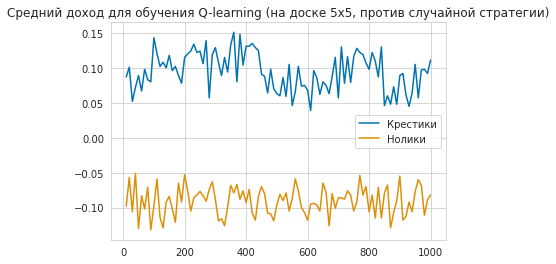

In [ ]:
plt.plot(
    [x['experiment'] for x in scores_55],
    [x['score_c'] for x in scores_55],
    label='Крестики'
)

plt.plot(
    [x['experiment'] for x in scores_55],
    [x['score_n'] for x in scores_55],
    label='Нолики'
)

plt.legend()
plt.title('Средний доход для обучения Q-learning (на доске 5x5, против случайной стратегии)')
plt.show()

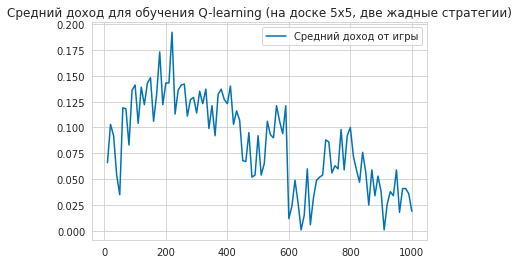

In [ ]:
plt.plot(
    [x['experiment'] for x in scores_55],
    [x['score'] for x in scores_55],
    label='Средний доход от игры'
)

plt.legend()
plt.title('Средний доход для обучения Q-learning (на доске 5x5, две жадные стратегии)')
plt.show()

* Cложно рост увидеть.
* При попытке поиграть со стратегией-оппонентом часто находим состояния, которые ни встретились ни разу (хотя было много exploration).
* Очень резко вырасло время обучения - даже на малом числе итераций оно вырасло в 2 раза в сравнении с 4-ой задачей (на 10_000 итераций, время ~ 4-6 часов)

In [ ]:
policy_crosses_55 = policy_q(Q_c_55, 0.0)

In [ ]:
len(Q_c_55)

10758

In [ ]:
env = TicTacToe(5, 5, 5)
env.reset()
env.printBoard()

---------------------
|   |   |   |   |   | 
---------------------
|   |   |   |   |   | 
---------------------
|   |   |   |   |   | 
---------------------
|   |   |   |   |   | 
---------------------
|   |   |   |   |   | 
---------------------


In [ ]:
env.step_int(policy_crosses_55(env))
env.printBoard()

---------------------
|   |   | x |   |   | 
---------------------
|   |   |   |   |   | 
---------------------
|   |   |   |   |   | 
---------------------
|   |   |   |   |   | 
---------------------
|   |   |   |   |   | 
---------------------


In [ ]:
env.step((2, 0))
env.printBoard()

---------------------
|   |   | x |   |   | 
---------------------
|   |   |   |   |   | 
---------------------
| o |   |   |   |   | 
---------------------
|   |   |   |   |   | 
---------------------
|   |   |   |   |   | 
---------------------


In [ ]:
env.getState() in Q_c_55

True

In [ ]:
env.getState()

('1121111111011111111111111', 1)

In [ ]:
next(iter(Q_c_55.keys()))

('2001121202200020021220012', 1)

## Часть вторая: добавим нейронных сетей

Реализуйте нейронную сеть для метода DQN на доске для крестиков-ноликов. Не буду ограничивать фантазию, но кажется, что свёртки $3x3$ здесь должны неплохо работать (в том числе обобщаться на доски размера побольше).

### 3. Реализуйте DQN с нейронной сетью, обучите стратегии крестиков и ноликов. Замечание: скорее всего, experience replay потребуется сразу же.

In [4]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

In [5]:
class ReplayMemory:
    def __init__(self, capacity):
        self.memory = []
        self.position = 0
        self.capacity = capacity
    
    def __len__(self):
        return len(self.memory)

    def sample(self, batch_size):
        return random.sample(self.memory, batch_size)

    def store(self, exptuple):
        if len(self.memory) < self.capacity:
            self.memory.append(None)
        self.memory[self.position] = exptuple
        self.position = (self.position + 1) % self.capacity
        

Опишем функцию, которая будет играть по политике, определяемой предсказаниями нейросети

In [6]:
def policy_nn(nn, eps=0.0):
    def strategy(env):
        if (random.random() <= eps):
            return env.randomIntAction()
        
        with torch.no_grad():
            state = torch.tensor(np.expand_dims(env.board, axis=(0, 1)), dtype=torch.float32)
            q = nn(state)[0].data.cpu().numpy()
            available_actions = env.getEmptyInts()
            return available_actions[np.argmax(q[available_actions])]
        
    return strategy

модель:
* простую сеть с одним сверточным слоем (по размеру доски) + несколько линейных слоев (с нелинейностями между ними).
* При увеличении размера доски количество сверток и количество линейных слоев увеличивается .

In [7]:
class Network(nn.Module):
    def __init__(self, n_rows=3, n_cols=3):
        super().__init__()
        
        n_convs = int(((n_rows + n_cols) / 2 - 1) * n_rows * n_cols)
        conv_output = n_convs
        
        self.conv1 = nn.Sequential(
            nn.Conv2d(1, n_convs, kernel_size=(n_rows, n_cols)),
            nn.ReLU(),
            nn.Flatten()
        )
        
        hidden_size = int(1.5 * conv_output)
        self.linear = [
            nn.Linear(conv_output, hidden_size),
            nn.Tanh(),
            nn.Dropout(0.1)
        ]

        for i in range(3**(max(n_rows, n_cols) - 2) - 2):
            self.linear.append(nn.Linear(hidden_size, hidden_size))
            self.linear.append(nn.ReLU())
            self.linear.append(nn.Dropout(0.1))

        self.linear.append(nn.Linear(hidden_size, n_rows * n_cols))
        self.linear.append(nn.Tanh())
        self.linear = nn.Sequential(*self.linear)
                
    def forward(self, x):
        x = self.conv1(x)
        x = self.linear(x)
        return x
    

In [14]:
def init_weights(m):
    if type(m) == nn.Linear:
        torch.nn.init.xavier_uniform_(m.weight)
        m.bias.data.fill_(0.01)
    elif type(m) == nn.Conv2d:
        torch.nn.init.xavier_uniform_(m.weight)

In [15]:
class TicTacToeDQN:
    def __init__(
        self, 
        n_rows=3, 
        n_cols=3, 
        n_win=3, 
        eps_generator=eps_constant(0.85),
        batch_size=64, 
        gamma=0.95
    ):
        self.gamma = gamma
        self.batch_size = batch_size
        self.eps_generator = eps_generator
        self.n_rows, self.n_cols, self.n_win = n_rows, n_cols, n_win
        
        self.env = TicTacToe(n_rows, n_cols, n_win)

        self.model_naughts = Network(n_rows, n_cols)
        self.model_naughts.apply(init_weights)
        self.model_naughts = ReplayMemory(100000)
        self.policy_naughts = lambda eps: policy_nn(self.model_naughts, eps)(self.env)
        self.optimizer_naughts = optim.Adam(self.model_naughts.parameters(), 1e-3)

        self.memory_crosses = ReplayMemory(100000)
        self.model_crosses = Network(n_rows, n_cols)
        self.model_crosses.apply(init_weights)
        self.policy_crosses = lambda eps: policy_nn(self.model_crosses, eps)(self.env)
        self.optimizer_crosses = optim.Adam(self.model_crosses.parameters(), 1e-3)
              
    def run_episode(
        self, 
        e=0, 
        use_crosses=lambda: (random.random() > 0.5),
        do_learning=True,
        greedy=False, 
        render=False
    ):
        crosses = use_crosses()
        if render:
            print('Играем за крестики' if crosses else 'Играем за нолики')
            
        eps = next(self.eps_generator)
    
        self.model_crosses.eval()
        self.model_naughts.eval()
        
        self.env.reset()
        
        if crosses:
            policy_main, policy_other = self.policy_crosses, self.policy_naughts
        else:
            policy_main, policy_other = self.policy_naughts, self.policy_crosses
            self.env.step_int(self.policy_crosses(0.0))
        
        self.run(policy_main, policy_other, crosses, do_learning)

    
    def run(self, policy_main, policy_other, crosses, do_learning):
        while True:
            state = self.state_tensor()
            action = policy_main(eps)
            _, reward, done, _ = self.env.step_int(action)
            next_state = self.state_tensor()
            if not crosses:
                reward *= -1
            
            if not done:
                _, reward, done, _ = self.env.step_int(policy_other(eps))
                next_state = self.state_tensor()
                
                if not crosses:
                    reward *= -1
                
            if do_learning:
                record = (state, action, reward, next_state)
                
                if crosses:
                    self.memory_crosses.store(record)
                else:
                    self.memory_naughts.store(record)

                self.fit()

                self.model_naughts.eval()
                self.model_crosses.eval()
                
                if render:
                    print('state: ', state)
                    print('next_state: ', next_state)
                    print('reward: ', reward)
                    print('done: ', done)
                    print('#######################')
            
            if done:
                break
    
    def fit(self):
        if (len(self.memory_crosses) < self.batch_size) or \
            (len(self.memory_naughts) < self.batch_size):
            return
        
        self.model_crosses.train()
        self.model_naughts.train()
        
        iterables = [
            (self.model_crosses, self.memory_crosses, self.optimizer_crosses),
            (self.model_naughts, self.memory_naughts, self.optimizer_naughts),
        ]
        for (model, memory, optimizer) in iterables:
            records = memory.sample(self.batch_size)
            batch_state, batch_action, batch_reward, batch_next_state = zip(*records)
            
            batch_state = torch.cat(batch_state, dim=0)
            batch_action = torch.tensor(batch_action, dtype=torch.int64).unsqueeze(1)
            batch_reward = torch.tensor(batch_reward, dtype=torch.float32)
            batch_next_state = torch.cat(batch_next_state, dim=0)

            Q = model(batch_state).gather(1, batch_action).reshape([self.batch_size])

            Qmax = model(batch_next_state).detach().max(1)[0]
            Qnext = batch_reward + (self.gamma * Qmax)

            loss = F.smooth_l1_loss(Q, Qnext)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

    def state_tensor(self):
        return torch.tensor(
            np.expand_dims(self.env.board, axis=(0, 1)), 
            dtype=torch.float32
        )


In [16]:
def plot_nn_learning(dqn, n_episodes=1_000, score_every=10, algo='DQN'):
    scores = []
    for i in tqdm(range(n_episodes)):
        if (i % score_every) == 0:
            score, _ = calculate_reward_by_policies(
                policy_nn(dqn.model_crosses.eval()), 
                policy_nn(dqn.model_naughts.eval()), 
                num_experiments=1000, 
                env=TicTacToe(dqn.n_rows, dqn.n_cols, dqn.n_win)
            )
            _, score_n = calculate_reward_by_policies(
                policy_random(), 
                policy_nn(dqn.model_naughts.eval()), 
                num_experiments=1000, 
                env=TicTacToe(dqn.n_rows, dqn.n_cols, dqn.n_win)
            )
            score_c, _ = calculate_reward_by_policies(
                policy_nn(dqn.model_crosses.eval()), 
                policy_random(), 
                num_experiments=1000,
                 env=TicTacToe(dqn.n_rows, dqn.n_cols, dqn.n_win)
            )
            
            
            scores.append({
                'experiment': i + 1,
                'score_c': score_c,
                'score_n': score_n,
                'score': score,
            })
            
            print(
                f'Score at {i+1} / {n_episodes} = {score_c}/{score_n}/{score}', 
                flush=True
            )
        
        # Обучение
        dqn.run_episode(e=i)
     
    # Строим графики
    plt.plot(
        [x['experiment'] for x in scores],
        [x['score_c'] for x in scores],
        label='Крестики'
    )
    plt.plot(
        [x['experiment'] for x in scores],
        [x['score_n'] for x in scores],
        label='Нолики'
    )
    plt.legend()
    plt.title(f'Средний доход по ходу обучения {algo} на доске {dqn.n_rows}x{dqn.n_cols} (игра против случайной стратегии)')
    plt.show()
    
    plt.plot(
        [x['experiment'] for x in scores],
        [x['score'] for x in scores],
        label='Средний доход от игры'
    )
    plt.legend()
    plt.title(f'Средний доход по ходу обучения {algo} на доске {dqn.n_rows}x{dqn.n_cols} (две жадные стратегии)')
    plt.show()

#### $3x3$

In [50]:
torch.manual_seed(100500)
random.seed(100500)
np.random.seed(100500)


dqn33 = TicTacToeDQN(
    3, 3, 3, 
    eps_generator=eps_constant(0.85),
    batch_size=512, 
)

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 1 / 1000 = 0.23/-0.666/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 21 / 1000 = 0.223/-0.701/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 41 / 1000 = 0.273/-0.68/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 61 / 1000 = 0.225/-0.68/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 81 / 1000 = 0.271/-0.69/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 101 / 1000 = 0.259/-0.643/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 121 / 1000 = 0.261/-0.683/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 141 / 1000 = 0.209/-0.724/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 161 / 1000 = 0.265/-0.658/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 181 / 1000 = 0.308/-0.633/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 201 / 1000 = 0.203/-0.698/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 221 / 1000 = 0.252/-0.675/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 241 / 1000 = 0.29/-0.682/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 261 / 1000 = 0.228/-0.702/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 281 / 1000 = 0.228/-0.716/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 301 / 1000 = 0.208/-0.595/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 321 / 1000 = 0.545/0.177/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 341 / 1000 = 0.38/0.096/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 361 / 1000 = 0.328/0.059/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 381 / 1000 = 0.121/0.057/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 401 / 1000 = 0.276/0.082/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 421 / 1000 = 0.354/0.002/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 441 / 1000 = 0.292/0.094/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 461 / 1000 = 0.382/0.073/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 481 / 1000 = 0.3/0.171/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 501 / 1000 = 0.391/0.277/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 521 / 1000 = 0.337/0.207/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 541 / 1000 = 0.212/0.218/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 561 / 1000 = 0.122/0.298/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 581 / 1000 = 0.17/0.243/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 601 / 1000 = 0.276/0.318/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 621 / 1000 = 0.234/0.236/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 641 / 1000 = 0.274/0.255/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 661 / 1000 = 0.286/0.279/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 681 / 1000 = 0.311/0.281/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 701 / 1000 = 0.388/0.296/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 721 / 1000 = 0.37/0.219/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 741 / 1000 = 0.304/0.263/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 761 / 1000 = 0.344/0.235/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 781 / 1000 = 0.259/0.237/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 801 / 1000 = 0.315/0.268/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 821 / 1000 = 0.414/0.237/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 841 / 1000 = 0.336/0.306/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 861 / 1000 = 0.411/0.281/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 881 / 1000 = 0.537/0.288/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 901 / 1000 = 0.614/0.272/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 921 / 1000 = 0.623/0.296/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 941 / 1000 = 0.611/0.213/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 961 / 1000 = 0.525/0.29/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 981 / 1000 = 0.612/0.246/1.0


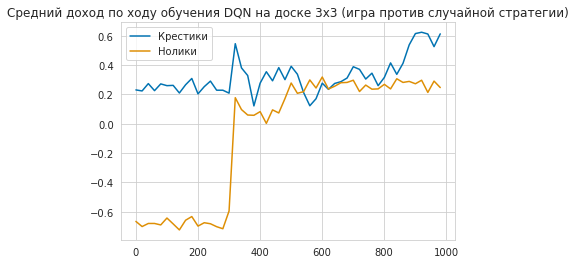

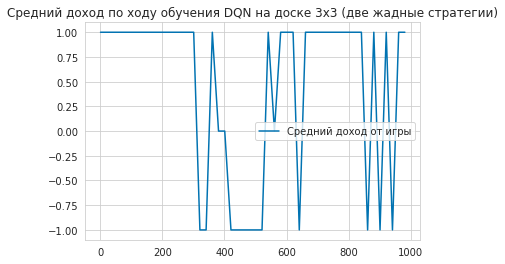

In [ ]:
plot_nn_learning(dqn33, n_episodes=1_000, score_every=20)

#### $4x4$

In [ ]:
torch.manual_seed(100500)
random.seed(100500)
np.random.seed(100500)


dqn44 = TicTacToeDQN(
    4, 4, 4, 
    eps_generator=eps_constant(0.85),
    batch_size=512, 
)

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 1 / 1000 = -0.142/-0.049/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 41 / 1000 = -0.124/-0.049/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 81 / 1000 = -0.157/-0.012/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 121 / 1000 = -0.1/-0.038/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 161 / 1000 = 0.023/0.057/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 201 / 1000 = 0.478/0.311/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 241 / 1000 = 0.467/0.31/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 281 / 1000 = 0.487/0.266/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 321 / 1000 = 0.514/0.256/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 361 / 1000 = 0.517/-0.06/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 401 / 1000 = 0.507/-0.028/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 441 / 1000 = 0.504/0.079/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 481 / 1000 = 0.467/0.15/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 521 / 1000 = 0.523/0.147/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 561 / 1000 = 0.531/0.1/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 601 / 1000 = 0.491/0.034/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 641 / 1000 = 0.498/0.108/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 681 / 1000 = 0.517/0.236/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 721 / 1000 = 0.457/-0.065/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 761 / 1000 = 0.506/-0.005/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 801 / 1000 = 0.472/-0.05/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 841 / 1000 = 0.474/0.006/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 881 / 1000 = 0.507/0.066/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 921 / 1000 = 0.5/0.0/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 961 / 1000 = 0.49/0.063/1.0


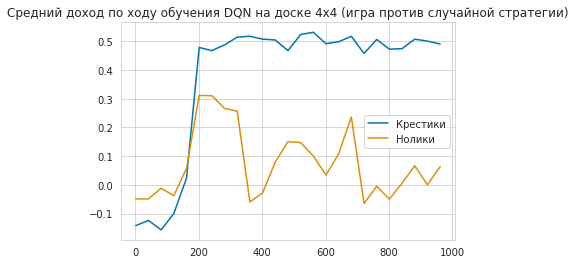

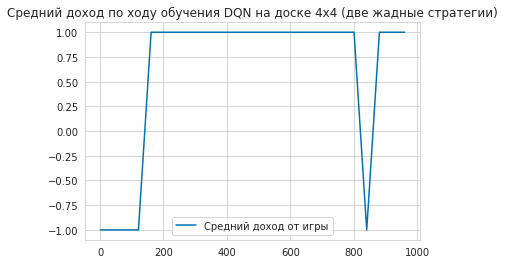

In [ ]:
plot_nn_learning(
    dqn44, 
    n_episodes=1_000, 
    score_every=40
)

#### $5x5$

In [ ]:
torch.manual_seed(100500)
random.seed(100500)
np.random.seed(100500)

dqn55 = TicTacToeDQN(
    5, 5, 5,
    eps_generator=eps_constant(0.85),
    batch_size=512
)

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 1 / 1000 = -0.187/-0.061/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 11 / 1000 = -0.131/-0.098/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 21 / 1000 = -0.139/-0.076/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 31 / 1000 = -0.171/-0.032/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 41 / 1000 = -0.142/-0.037/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 51 / 1000 = -0.192/-0.072/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 61 / 1000 = -0.167/-0.017/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 71 / 1000 = -0.107/-0.055/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 81 / 1000 = -0.166/-0.058/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 91 / 1000 = -0.19/-0.066/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 101 / 1000 = 0.588/0.281/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 111 / 1000 = 0.592/0.277/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 121 / 1000 = 0.615/0.254/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 131 / 1000 = 0.575/0.276/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 141 / 1000 = 0.584/0.218/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 151 / 1000 = 0.594/0.265/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 161 / 1000 = 0.612/0.23/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 171 / 1000 = 0.604/0.251/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 181 / 1000 = 0.596/0.224/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 191 / 1000 = 0.595/0.335/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 201 / 1000 = 0.6/0.194/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 211 / 1000 = 0.593/0.267/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 221 / 1000 = 0.585/0.282/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 231 / 1000 = 0.619/0.221/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 241 / 1000 = 0.606/0.267/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 251 / 1000 = 0.585/0.254/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 261 / 1000 = 0.604/0.252/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 271 / 1000 = 0.6/0.266/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 281 / 1000 = 0.615/0.25/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 291 / 1000 = 0.603/0.263/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 301 / 1000 = 0.633/0.263/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 311 / 1000 = 0.62/0.206/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 321 / 1000 = 0.578/0.237/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 331 / 1000 = 0.605/0.304/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 341 / 1000 = 0.623/0.23/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 351 / 1000 = 0.585/0.23/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 361 / 1000 = 0.627/0.199/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 371 / 1000 = 0.573/0.233/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 381 / 1000 = 0.642/0.26/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 391 / 1000 = 0.576/0.232/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 401 / 1000 = 0.591/0.26/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 411 / 1000 = 0.597/0.244/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 421 / 1000 = 0.622/0.317/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 431 / 1000 = 0.605/0.314/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 441 / 1000 = 0.623/0.3/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 451 / 1000 = 0.569/0.233/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 461 / 1000 = 0.596/0.191/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 471 / 1000 = 0.626/0.217/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 481 / 1000 = 0.635/0.3/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 491 / 1000 = 0.615/0.186/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 501 / 1000 = 0.579/0.263/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 511 / 1000 = 0.586/0.224/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 521 / 1000 = 0.624/0.225/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 531 / 1000 = 0.619/0.24/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 541 / 1000 = 0.589/0.246/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 551 / 1000 = 0.566/0.203/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 561 / 1000 = 0.609/0.254/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 571 / 1000 = 0.606/0.224/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 581 / 1000 = 0.602/0.283/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 591 / 1000 = 0.638/0.233/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 601 / 1000 = 0.593/0.211/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 611 / 1000 = 0.614/0.232/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 621 / 1000 = 0.59/0.28/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 631 / 1000 = 0.608/0.192/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 641 / 1000 = 0.615/0.247/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 651 / 1000 = 0.605/0.198/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 661 / 1000 = 0.641/0.232/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 671 / 1000 = 0.586/0.229/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 681 / 1000 = 0.615/0.243/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 691 / 1000 = 0.605/0.213/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 701 / 1000 = 0.61/0.235/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 711 / 1000 = 0.622/0.268/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 721 / 1000 = 0.608/0.252/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 731 / 1000 = 0.582/0.241/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 741 / 1000 = 0.603/0.307/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 751 / 1000 = 0.608/0.283/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 761 / 1000 = 0.616/0.276/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 771 / 1000 = 0.644/0.269/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 781 / 1000 = 0.619/0.256/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 791 / 1000 = 0.633/0.244/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 801 / 1000 = 0.597/0.256/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 811 / 1000 = 0.618/0.276/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 821 / 1000 = 0.58/0.264/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 831 / 1000 = 0.608/0.271/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 841 / 1000 = 0.613/0.274/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 851 / 1000 = 0.597/0.242/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 861 / 1000 = 0.612/0.213/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 871 / 1000 = 0.612/0.208/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 881 / 1000 = 0.595/0.206/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 891 / 1000 = 0.555/0.288/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 901 / 1000 = 0.626/0.248/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 911 / 1000 = 0.594/0.206/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 921 / 1000 = 0.586/0.21/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 931 / 1000 = 0.617/0.22/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 941 / 1000 = 0.581/0.249/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 951 / 1000 = 0.578/0.283/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 961 / 1000 = 0.606/0.271/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 971 / 1000 = 0.639/0.268/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 981 / 1000 = 0.563/0.239/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 991 / 1000 = 0.554/0.212/1.0


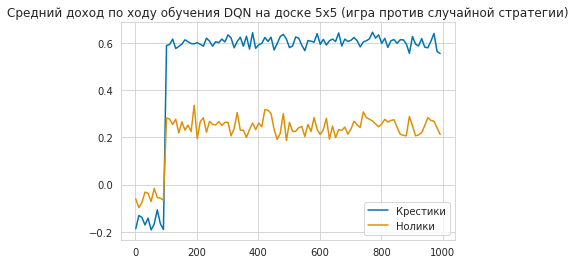

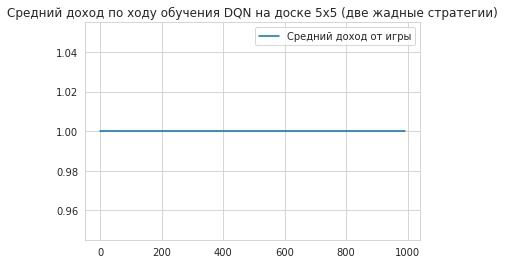

In [ ]:
plot_nn_learning(
    dqn55,
    n_episodes=1_000,
    score_every=10
)

* В целом видно, что все три модели к чему-то сходятся
* На больших досках это неприятно долго работает
* Для 1000 итераций результаты не очень показательны, при 2 жадных стратегиях получаем всегде победа только одних - в это слабо верится

Для доски $5x5$ всего для 1_000 эпизодов и то занял ~ 3ч

### 4. Реализуйте Double DQN и/или Dueling DQN.

In [17]:
def plot_nn_learning_double(
      dqn, 
      n_episodes=1_000,
      score_every=10,
      algo='Double DQN'
  ):
    scores = []
    
    try:
        for i in tqdm(range(n_episodes)):
            if (i % score_every) == 0:
                score_c, _ = calculate_reward_by_policies(
                    policy_nn(dqn.models_crosses[0].eval()), 
                    policy_random(),
                    num_experiments=1000, 
                    env=TicTacToe(dqn.n_rows, dqn.n_cols, dqn.n_win)
                )
                score, _ = calculate_reward_by_policies(
                    policy_nn(dqn.models_crosses[0].eval()),
                    policy_nn(dqn.models_naughts[0].eval()), 
                    num_experiments=1000, 
                    env=TicTacToe(dqn.n_rows, dqn.n_cols, dqn.n_win)
                )
                _, score_n = calculate_reward_by_policies(
                    policy_random(), 
                    policy_nn(dqn.models_naughts[0].eval()),
                    num_experiments=1000, 
                    env=TicTacToe(dqn.n_rows, dqn.n_cols, dqn.n_win)
                )

                scores.append({
                    'experiment': i + 1,
                    'score_c': score_c,
                    'score_n': score_n,
                    'score': score,
                })

                print(
                    f'Score at {i+1} / {n_episodes} = {score_c}/{score_n}/{score}',
                    flush=True
                )
        
            dqn.run_episode(e=i)
    except KeyboardInterrupt:
        pass
     
    plt.plot(
        [x['experiment'] for x in scores],
        [x['score_c'] for x in scores],
        label='Крестики'
    )
    plt.plot(
        [x['experiment'] for x in scores],
        [x['score_n'] for x in scores],
        label='Нолики'
    )
    plt.legend()
    plt.title(f'Средний доход для обучения {algo} на доске {dqn.n_rows}x{dqn.n_cols} (игра против случайной стратегии)')
    plt.show()
    
    plt.plot(
        [x['experiment'] for x in scores],
        [x['score'] for x in scores],
        label='Средний доход от игры'
    )
    plt.legend()
    plt.title(f'Средний доход для обучения {algo} на доске {dqn.n_rows}x{dqn.n_cols} (две жадные стратегии)')
    plt.show()

In [8]:
class DuelingNetwork(nn.Module):
    def __init__(self, n_rows=3, n_cols=3):
        super().__init__()

        n_convs = int(((n_rows + n_cols) / 2 - 1) * n_rows * n_cols)

        self.embed = nn.Sequential(
            nn.Conv2d(1, n_convs, kernel_size=(n_rows, n_cols)),
            nn.ReLU(),
            nn.Flatten()
        )
        
        conv_output = n_convs
        
        hidden_size = int(1.5 * conv_output)

        self.v_layer = [
            nn.Linear(conv_output, hidden_size),
            nn.Tanh(),
            nn.Dropout(0.1)
        ]
        for i in range(3**(max(n_rows, n_cols) - 2) - 2):
            self.v_layer.append(nn.Linear(hidden_size, hidden_size))
            self.v_layer.append(nn.ReLU())
            self.v_layer.append(nn.Dropout(0.1))
        self.v_layer.append(nn.Linear(hidden_size, 1))
        self.v_layer.append(nn.Tanh())
        self.v_layer = nn.Sequential(*self.v_layer)

        self.a_layer = [
            nn.Linear(conv_output, hidden_size),
            nn.Tanh(),
            nn.Dropout(0.1)
        ]
        for i in range(3**(max(n_rows, n_cols) - 2) - 2):
            self.a_layer.append(nn.Linear(hidden_size, hidden_size))
            self.a_layer.append(nn.ReLU())
            self.a_layer.append(nn.Dropout(0.1))
        self.a_layer.append(nn.Linear(hidden_size, n_rows * n_cols))
        self.a_layer.append(nn.Tanh())
        self.a_layer = nn.Sequential(*self.a_layer)
                
    def forward(self, x):
        x = self.embed(x)
        v = self.v_layer(x)
        a = self.a_layer(x)
        ma = torch.mean(a, dim=1, keepdim=True)
        return v + a - ma
    

Опишем класс для обучения Dueling DQN

In [19]:
class TicTacToeDuelingDQN:
    def __init__(
        self, 
        n_rows=3, 
        n_cols=3, 
        n_win=3, 
        eps_generator=eps_constant(0.85),
        batch_size=64, 
        gamma=0.95
    ):
        self.n_rows, self.n_cols, self.n_win = n_rows, n_cols, n_win
        self.gamma = gamma
        self.batch_size = batch_size
        self.eps_generator = eps_generator
        
        self.env = TicTacToe(n_rows, n_cols, n_win)

        self.model_naughts = DuelingNetwork(n_rows, n_cols)
        self.model_naughts.apply(init_weights)
        self.memory_naughts = ReplayMemory(100_000)
        self.optimizer_naughts = optim.Adam(self.model_naughts.parameters(), 1e-3)
        self.policy_naughts = lambda eps: policy_nn(self.model_naughts, eps)(self.env)

        self.model_crosses = DuelingNetwork(n_rows, n_cols)
        self.model_crosses.apply(init_weights)
        self.memory_crosses = ReplayMemory(100000)
        self.optimizer_crosses = optim.Adam(self.model_crosses.parameters(), 1e-3)
        self.policy_crosses = lambda eps: policy_nn(self.model_crosses, eps)(self.env)
      
        
    def state_tensor(self):
        return torch.tensor(
            np.expand_dims(self.env.board, axis=(0, 1)), 
            dtype=torch.float32
        )
    
    def fit(self):
        if (len(self.memory_crosses) < self.batch_size) or \
         (len(self.memory_naughts) < self.batch_size):
            return
        
        self.model_crosses.train()
        self.model_naughts.train()
        
        iterables = [
            (self.model_crosses, self.memory_crosses, self.optimizer_crosses),
            (self.model_naughts, self.memory_naughts, self.optimizer_naughts),
        ]
        for (model, memory, optimizer) in iterables:
            records = memory.sample(self.batch_size)
            batch_state, batch_action, batch_reward, batch_next_state = zip(*records)
            
            batch_state = torch.cat(batch_state, dim=0)
            batch_action = torch.tensor(batch_action, dtype=torch.int64).unsqueeze(1)
            batch_reward = torch.tensor(batch_reward, dtype=torch.float32)
            batch_next_state = torch.cat(batch_next_state, dim=0)
            
            Q = model(batch_state).gather(1, batch_action).reshape([self.batch_size])

            Qmax = model(batch_next_state).detach().max(1)[0]
            Qnext = batch_reward + (self.gamma * Qmax)

            loss = F.smooth_l1_loss(Q, Qnext)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

    def run(self, policy_main, policy_other, crosses, do_learning):
        while True:
            state = self.state_tensor()
            action = policy_main(eps)
            _, reward, done, _ = self.env.step_int(action)
            next_state = self.state_tensor()
            if not crosses:
                reward *= -1
            
            if not done:
                _, reward, done, _ = self.env.step_int(policy_other(eps))
                next_state = self.state_tensor()
                
                if not crosses:
                    reward *= -1
                
            if do_learning:
                record = (state, action, reward, next_state)
                
                if crosses:
                    self.memory_crosses.store(record)
                else:
                    self.memory_naughts.store(record)
                    
                self.fit()
                
                self.model_crosses.eval()
                self.model_naughts.eval()
                
                if render:
                    print('state: ', state)
                    print('next_state: ', next_state)
                    print('reward: ', reward)
                    print('done: ', done)
                    print('#######################')
            
            if done:
                break

    def run_episode(
        self, 
        e=0, 
        do_learning=True,
        use_crosses=lambda: (random.random() > 0.5),
        render=False, 
        greedy=False,
      ):
        crosses = use_crosses()
        if render:
            print('Играем за крестики' if crosses else 'Играем за нолики')
            
        # Получаем текущий eps
        eps = next(self.eps_generator)
    
        self.model_crosses.eval()
        self.model_naughts.eval()
        
        self.env.reset()
        
        if not crosses:
            policy_main, policy_other = self.policy_naughts, self.policy_crosses
            self.env.step_int(self.policy_crosses(0.0))
        else:
            policy_main, policy_other = self.policy_crosses, self.policy_naughts
            
        self.run(policy_main, policy_other, crosses, do_learning)

Опишем класс для обучения Double Dueling DQN

In [20]:
class TicTacToeDoubleDuelingDQN:
    def __init__(
        self,
        n_rows=3, 
        n_cols=3, 
        n_win=3, 
        eps_generator=eps_constant(0.85),
        gamma=0.95, 
        batch_size=64
    ):
        self.eps_generator = eps_generator
        self.gamma = gamma
        self.batch_size = batch_size
        self.n_rows, self.n_cols, self.n_win = n_rows, n_cols, n_win

        self.models_naughts = [
            DuelingNetwork(n_rows, n_cols),
            DuelingNetwork(n_rows, n_cols)
        ]
        for model in self.models_naughts:
            model.apply(init_weights)

        self.memory_naughts = ReplayMemory(100000)
        self.policy_naughts = lambda eps: policy_nn(self.models_naughts[0], eps)(self.env)

        self.optimizers_naughts = [
            optim.Adam(self.models_naughts[0].parameters(), 1e-3),
            optim.Adam(self.models_naughts[1].parameters(), 1e-3)
        ]
        
        self.models_crosses = [
            DuelingNetwork(n_rows, n_cols),
            DuelingNetwork(n_rows, n_cols)
        ]

        self.env = TicTacToe(n_rows, n_cols, n_win)

        for model in self.models_crosses:
            model.apply(init_weights)    

        self.memory_crosses = ReplayMemory(100_000)

        self.optimizers_crosses = [
            optim.Adam(self.models_crosses[0].parameters(), 1e-3),
            optim.Adam(self.models_crosses[1].parameters(), 1e-3)
        ]
        self.policy_crosses = lambda eps: policy_nn(self.models_crosses[0], eps)(self.env)
        
        
        
    def state_tensor(self):
        return torch.tensor(
            np.expand_dims(self.env.board, axis=(0, 1)), 
            dtype=torch.float32
        )
    
    def fit(self):
        if (len(self.memory_crosses) < self.batch_size) or \
            (len(self.memory_naughts) < self.batch_size):
            return
        
        iterables = [
            (self.models_crosses, self.memory_crosses, self.optimizers_crosses),
            (self.models_naughts, self.memory_naughts, self.optimizers_naughts),
        ]
        for (models, memory, optimizers) in iterables:
            if random.random() > 0.5:
                model, other_model = models[0], models[1]
                optimizer = optimizers[0]
            else:
                model, other_model = models[1], models[0]
                optimizer = optimizers[1]
            
            model.train()
            other_model.eval()
            
            records = memory.sample(self.batch_size)
            batch_state, batch_action, batch_reward, batch_next_state = zip(*records)

            batch_state = torch.cat(batch_state, dim=0)
            batch_action = torch.tensor(batch_action, dtype=torch.int64).unsqueeze(1)
            batch_reward = torch.tensor(batch_reward, dtype=torch.float32)
            batch_next_state = torch.cat(batch_next_state, dim=0)
            
            Q = model(batch_state).gather(1, batch_action).reshape([self.batch_size])

            ind = torch.argmax(other_model(batch_next_state).detach(), 1)
            Qmax = model(batch_next_state).detach()[:, ind][: ,0]
            Qnext = batch_reward + (self.gamma * Qmax)

            loss = F.smooth_l1_loss(Q, Qnext)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

    def run(self, policy_main, policy_other, crosses, do_learning):
        while True:
            state = self.state_tensor()
            action = policy_main(eps)
            _, reward, done, _ = self.env.step_int(action)
            next_state = self.state_tensor()
            if not crosses:
                reward *= -1
            
            if not done:
                #_, reward, done, _ = self.env.step_int(policy_other(0.0))
                _, reward, done, _ = self.env.step_int(policy_other(eps))
                next_state = self.state_tensor()
                
                if not crosses:
                    reward *= -1
                
            if do_learning:
                record = (state, action, reward, next_state)
                
                if crosses:
                    self.memory_crosses.store(record)
                else:
                    self.memory_naughts.store(record)
                    
                self.fit()
                
                for model in self.models_crosses + self.models_naughts:
                    model.eval()
                
                if render:
                    print('state: ', state)
                    print('next_state: ', next_state)
                    print('reward: ', reward)
                    print('done: ', done)
                    print('#######################')
            
            if done:
                break

    def run_episode(
        self,
        e=0, 
        do_learning=True,
        greedy=False,
        render=False,
        use_crosses=lambda: (random.random() > 0.5)
    ):
        crosses = use_crosses()
        if render:
            print('Играем за крестики' if crosses else 'Играем за нолики')

        for model in self.models_crosses + self.models_naughts:
            model.eval()
        
        eps = next(self.eps_generator)
        self.env.reset()
        
        if not crosses:
            policy_main, policy_other = self.policy_naughts, self.policy_crosses
            self.env.step_int(self.policy_crosses(0.0))
        else:
            policy_main, policy_other = self.policy_crosses, self.policy_naughts
            
        self.run(policy_main, policy_other, crosses, do_learning)

Опишем класс для обучения обычного DQN

In [21]:
class TicTacToeDoubleDQN:
    def __init__(
        self,
        n_rows=3,
        n_cols=3, 
        n_win=3, 
        eps_generator=eps_constant(0.85),
        batch_size=64,
        gamma=0.95,
    ):
        self.eps_generator = eps_generator
        self.batch_size = batch_size
        self.gamma = gamma
        self.n_rows, self.n_cols, self.n_win = n_rows, n_cols, n_win
        
        self.env = TicTacToe(n_rows, n_cols, n_win)
        
        self.models_naughts = [
            Network(n_rows, n_cols),
            Network(n_rows, n_cols)
        ]
        self.models_naughts[0].apply(init_weights)
        self.models_naughts[1].load_state_dict(self.models_naughts[0].state_dict())
        self.memory_naughts = ReplayMemory(100000)
        self.optimizer_naughts = optim.Adam(self.models_naughts[0].parameters(), 1e-3)
        self.policy_naughts = lambda eps: policy_nn(self.models_naughts[0], eps)(self.env)

        self.models_crosses = [
            Network(n_rows, n_cols),
            Network(n_rows, n_cols)
        ]
        self.models_crosses[0].apply(init_weights)
        self.models_crosses[1].load_state_dict(self.models_crosses[0].state_dict())
        self.memory_crosses = ReplayMemory(100000)
        self.optimizer_crosses = optim.Adam(self.models_crosses[0].parameters(), 1e-3)
        self.policy_crosses = lambda eps: policy_nn(self.models_crosses[0], eps)(self.env)
        
    def state_tensor(self):
        return torch.tensor(
            np.expand_dims(self.env.board, axis=(0, 1)), 
            dtype=torch.float32
        )
    
    def fit(self):
        if (len(self.memory_crosses) < self.batch_size) or \
          (len(self.memory_naughts) < self.batch_size):
            return
        
        iterables = [
            (self.models_crosses, self.memory_crosses, self.optimizer_crosses),
            (self.models_naughts, self.memory_naughts, self.optimizer_naughts),
        ]
        for (models, memory, optimizer) in iterables:
            models[0].train()
            models[1].eval()
            
            records = memory.sample(self.batch_size)
            batch_state, batch_action, batch_reward, batch_next_state = zip(*records)
            
            batch_state = torch.cat(batch_state, dim=0)
            batch_action = torch.tensor(batch_action, dtype=torch.int64).unsqueeze(1)
            batch_reward = torch.tensor(batch_reward, dtype=torch.float32)
            batch_next_state = torch.cat(batch_next_state, dim=0)
            
            Q = models[0](batch_state).gather(1, batch_action).reshape([self.batch_size])

            idx = torch.argmax(models[1](batch_next_state).detach(), 1)
            Qmax = models[0](batch_next_state).detach()[:, ][: ,0]
            Qnext = batch_reward + (self.gamma * Qmax)

            loss = F.smooth_l1_loss(Q, Qnext)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()


    def run(self, policy_main, policy_other, crosses, do_learning):
        while True:
            state = self.state_tensor()
            action = policy_main(eps)
            _, reward, done, _ = self.env.step_int(action)
            next_state = self.state_tensor()
            if not crosses:
                reward *= -1
            
            if not done:
                _, reward, done, _ = self.env.step_int(policy_other(eps))
                next_state = self.state_tensor()
                
                if not crosses:
                    reward *= -1
                
            if do_learning:
                record = (state, action, reward, next_state)
                
                # Записываем опыт в память
                if crosses:
                    self.memory_crosses.store(record)
                else:
                    self.memory_naughts.store(record)
                    
                self.fit()
                
                if (e % 10) == 0:
                    self.models_crosses[1].load_state_dict(self.models_crosses[0].state_dict())
                    self.models_naughts[1].load_state_dict(self.models_naughts[0].state_dict())
                
                for model in self.models_crosses + self.models_naughts:
                    model.eval()
                
                if render:
                    print('state: ', state)
                    print('next_state: ', next_state)
                    print('reward: ', reward)
                    print('done: ', done)
                    print('#######################')
            
            if done:
                break

    def run_episode(
        self, 
        e=0, 
        do_learning=True, 
        use_crosses=lambda: (random.random() > 0.5),
        greedy=False, 
        render=False
    ):
        crosses = use_crosses()
        if render:
            print('Играем за крестики' if crosses else 'Играем за нолики')
            
        eps = next(self.eps_generator)
    
        for model in self.models_crosses + self.models_naughts:
            model.eval()
        
        self.env.reset()
        
        if not crosses:
            policy_main, policy_other = self.policy_naughts, self.policy_crosses
            self.env.step_int(self.policy_crosses(0.0))
        else:
            policy_main, policy_other = self.policy_crosses, self.policy_naughts
        
        self.run(policy_main, policy_other, crosses, do_learning)    
        

#### Double DQN $3x3$

In [53]:
torch.manual_seed(100500)
random.seed(100500)
np.random.seed(100500)

double_dqn33 = TicTacToeDoubleDQN(
    3, 3, 3, 
    eps_generator=eps_constant(0.85),
    batch_size=512
)

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 1 / 1000 = 0.046/0.039/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 21 / 1000 = 0.034/0.002/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 41 / 1000 = 0.024/0.103/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 61 / 1000 = 0.054/0.071/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 81 / 1000 = 0.015/0.032/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 101 / 1000 = 0.014/0.043/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 121 / 1000 = 0.004/0.064/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 141 / 1000 = 0.038/0.035/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 161 / 1000 = 0.051/0.053/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 181 / 1000 = 0.037/0.098/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 201 / 1000 = 0.091/0.123/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 221 / 1000 = 0.027/0.09/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 241 / 1000 = 0.036/0.044/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 261 / 1000 = 0.026/0.079/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 281 / 1000 = 0.053/0.093/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 301 / 1000 = 0.039/0.038/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 321 / 1000 = 0.072/0.061/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 341 / 1000 = 0.624/-0.074/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 361 / 1000 = 0.638/0.231/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 381 / 1000 = 0.747/0.273/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 401 / 1000 = 0.708/0.285/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 421 / 1000 = 0.692/0.271/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 441 / 1000 = 0.705/0.301/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 461 / 1000 = 0.753/0.263/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 481 / 1000 = 0.646/0.235/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 501 / 1000 = 0.746/0.213/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 521 / 1000 = 0.73/0.316/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 541 / 1000 = 0.734/0.385/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 561 / 1000 = 0.823/0.426/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 581 / 1000 = 0.764/0.36/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 601 / 1000 = 0.848/0.361/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 621 / 1000 = 0.771/0.292/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 641 / 1000 = 0.816/0.335/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 661 / 1000 = 0.802/0.264/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 681 / 1000 = 0.809/0.281/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 701 / 1000 = 0.816/0.278/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 721 / 1000 = 0.833/0.233/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 741 / 1000 = 0.823/0.116/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 761 / 1000 = 0.813/0.119/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 781 / 1000 = 0.801/0.059/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 801 / 1000 = 0.771/0.118/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 821 / 1000 = 0.779/0.14/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 841 / 1000 = 0.807/0.118/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 861 / 1000 = 0.82/0.137/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 881 / 1000 = 0.758/0.172/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 901 / 1000 = 0.797/0.176/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 921 / 1000 = 0.742/0.039/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 941 / 1000 = 0.83/0.141/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 961 / 1000 = 0.695/0.113/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 981 / 1000 = 0.703/0.07/0.0


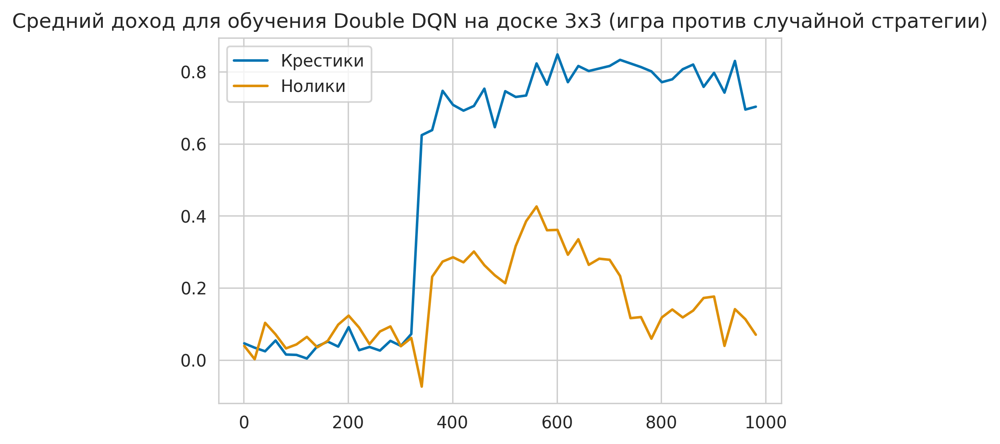

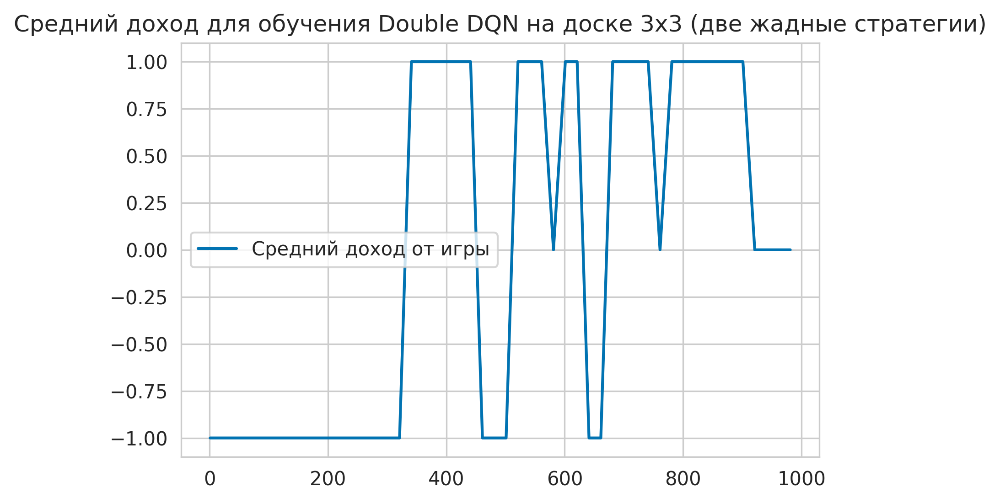

In [ ]:
plot_nn_learning_double(
    double_dqn33,
    n_episodes=1_000, 
    score_every=20, 
    algo='Double DQN'
)

#### Double DQN $4x4$

In [ ]:
torch.manual_seed(100500)
random.seed(100500)
np.random.seed(100500)


double_dqn44 = TicTacToeDoubleDQN(
    4, 4, 4, 
    eps_generator=eps_constant(0.85),
    batch_size=512
)

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 1 / 1000 = -0.172/0.022/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 41 / 1000 = -0.128/0.013/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 81 / 1000 = -0.2/-0.034/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 121 / 1000 = -0.167/0.028/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 161 / 1000 = 0.538/0.32/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 201 / 1000 = 0.479/0.312/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 241 / 1000 = 0.55/0.033/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 281 / 1000 = 0.512/-0.01/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 321 / 1000 = 0.494/-0.055/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 361 / 1000 = 0.486/0.078/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 401 / 1000 = 0.497/0.058/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 441 / 1000 = 0.498/0.053/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 481 / 1000 = 0.478/0.103/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 521 / 1000 = 0.512/0.074/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 561 / 1000 = 0.523/-0.044/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 601 / 1000 = 0.459/0.08/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 641 / 1000 = 0.485/0.024/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 681 / 1000 = 0.489/0.077/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 721 / 1000 = 0.5/0.104/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 761 / 1000 = 0.487/0.11/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 801 / 1000 = 0.485/0.051/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 841 / 1000 = 0.553/0.234/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 881 / 1000 = 0.466/0.194/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 921 / 1000 = 0.497/0.109/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 961 / 1000 = 0.533/0.098/1.0


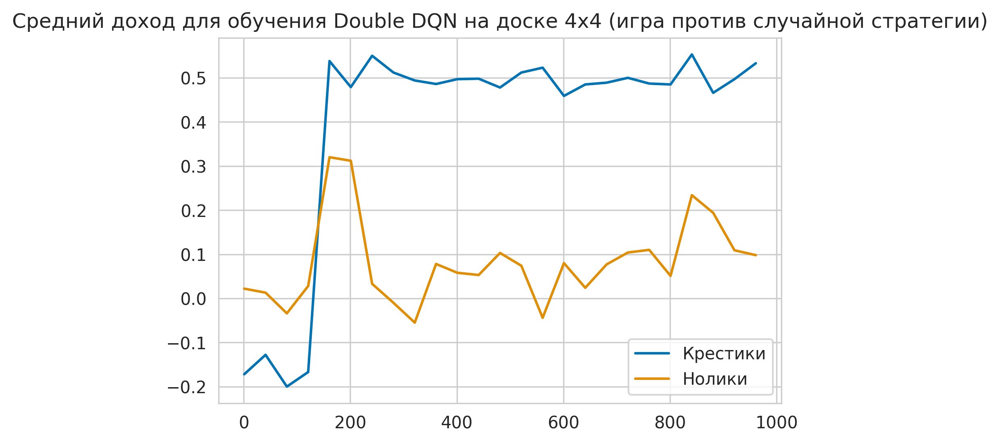

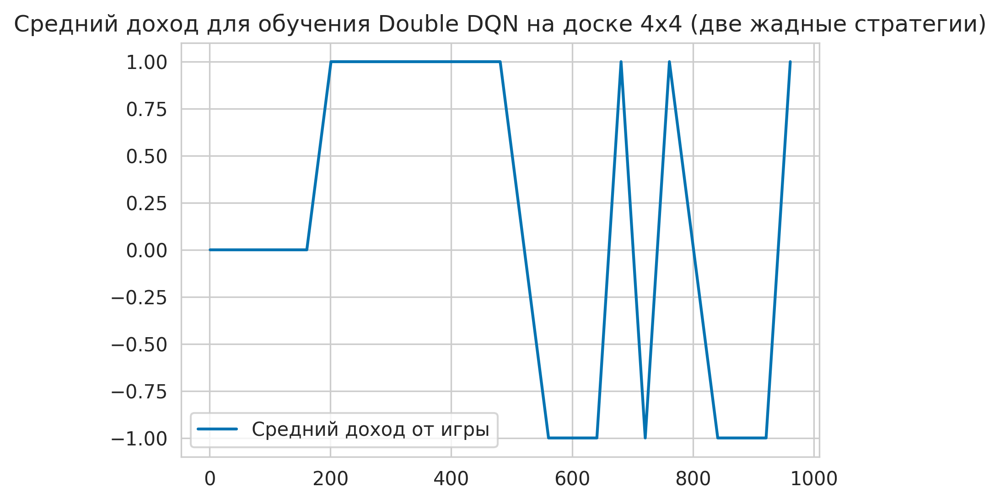

In [ ]:
plot_nn_learning_double(
    double_dqn44, 
    n_episodes=1_000, 
    score_every=40, 
    algo='Double DQN'
)

#### Double DQN $5x5$

In [28]:
torch.manual_seed(100500)
random.seed(100500)
np.random.seed(100500)

double_dqn55 = TicTacToeDoubleDQN(
    5, 5, 5, 
    eps_generator=eps_constant(0.85),
    batch_size=512
)

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 1 / 1000 = 0.214/-0.197/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 41 / 1000 = 0.199/-0.201/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 81 / 1000 = 0.187/-0.178/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 121 / 1000 = 0.617/0.189/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 161 / 1000 = 0.582/0.283/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 201 / 1000 = 0.621/0.254/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 241 / 1000 = 0.618/0.208/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 281 / 1000 = 0.593/0.292/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 321 / 1000 = 0.616/0.251/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 361 / 1000 = 0.584/0.273/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 401 / 1000 = 0.583/0.222/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 441 / 1000 = 0.583/0.227/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 481 / 1000 = 0.629/0.227/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 521 / 1000 = 0.612/0.229/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 561 / 1000 = 0.593/0.251/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 601 / 1000 = 0.648/0.22/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 641 / 1000 = 0.609/0.188/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 681 / 1000 = 0.637/0.233/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 721 / 1000 = 0.583/0.248/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 761 / 1000 = 0.604/0.244/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 801 / 1000 = 0.644/0.267/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 841 / 1000 = 0.614/0.254/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 881 / 1000 = 0.596/0.275/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 921 / 1000 = 0.58/0.239/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 961 / 1000 = 0.625/0.226/1.0


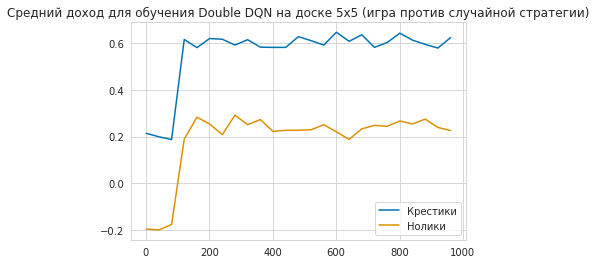

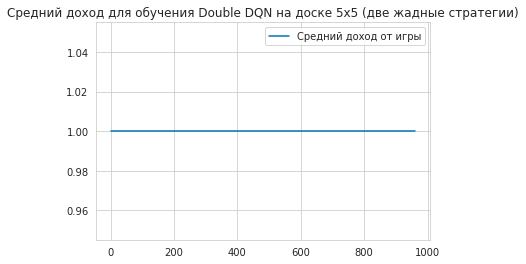

In [29]:
plot_nn_learning_double(
    double_dqn55, 
    n_episodes=1_000, 
    score_every=40, 
    algo='Double DQN'
)

#### Double Dueling DQN $3x3$

In [54]:
torch.manual_seed(100500)
random.seed(100500)
np.random.seed(100500)

double_dueling_dqn33 = TicTacToeDoubleDuelingDQN(
    3, 3, 3, 
    eps_generator=eps_constant(0.85),
    batch_size=512
)

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 1 / 1000 = 0.017/-0.366/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 21 / 1000 = 0.068/-0.362/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 41 / 1000 = 0.103/-0.359/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 61 / 1000 = 0.019/-0.408/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 81 / 1000 = 0.122/-0.397/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 101 / 1000 = 0.048/-0.372/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 121 / 1000 = 0.058/-0.401/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 141 / 1000 = 0.125/-0.354/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 161 / 1000 = 0.013/-0.357/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 181 / 1000 = 0.114/-0.394/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 201 / 1000 = 0.056/-0.335/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 221 / 1000 = 0.082/-0.392/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 241 / 1000 = 0.049/-0.386/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 261 / 1000 = 0.651/-0.068/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 281 / 1000 = 0.691/0.136/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 301 / 1000 = 0.633/0.0/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 321 / 1000 = 0.719/0.013/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 341 / 1000 = 0.675/-0.089/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 361 / 1000 = 0.814/0.061/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 381 / 1000 = 0.691/0.134/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 401 / 1000 = 0.709/0.253/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 421 / 1000 = 0.753/0.132/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 441 / 1000 = 0.679/0.289/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 461 / 1000 = 0.684/0.242/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 481 / 1000 = 0.723/0.317/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 501 / 1000 = 0.766/0.298/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 521 / 1000 = 0.727/0.339/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 541 / 1000 = 0.77/0.271/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 561 / 1000 = 0.733/0.331/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 581 / 1000 = 0.747/0.262/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 601 / 1000 = 0.745/0.353/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 621 / 1000 = 0.789/0.298/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 641 / 1000 = 0.787/0.368/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 661 / 1000 = 0.806/0.344/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 681 / 1000 = 0.804/0.339/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 701 / 1000 = 0.804/0.364/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 721 / 1000 = 0.807/0.383/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 741 / 1000 = 0.777/0.308/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 761 / 1000 = 0.807/0.383/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 781 / 1000 = 0.847/0.305/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 801 / 1000 = 0.867/0.303/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 821 / 1000 = 0.774/0.329/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 841 / 1000 = 0.803/0.299/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 861 / 1000 = 0.798/0.294/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 881 / 1000 = 0.854/0.404/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 901 / 1000 = 0.855/0.381/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 921 / 1000 = 0.876/0.497/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 941 / 1000 = 0.89/0.464/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 961 / 1000 = 0.903/0.409/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 981 / 1000 = 0.926/0.463/1.0


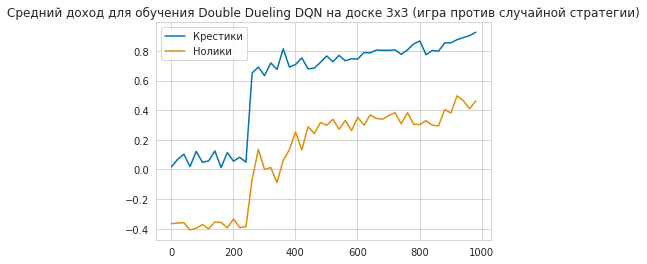

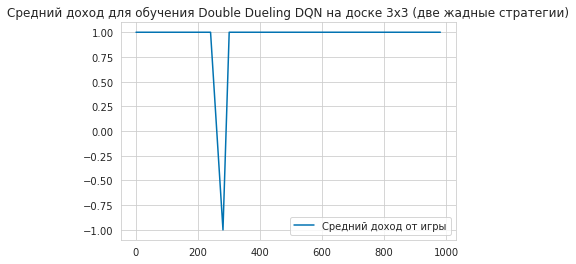

In [34]:
plot_nn_learning_double(
    double_dueling_dqn33, 
    n_episodes=1_000, 
    score_every=20, 
    algo='Double Dueling DQN'
)

#### Double Dueling $4x4$

In [35]:
torch.manual_seed(100500)
random.seed(100500)
np.random.seed(100500)


double_dueling_dqn44 = TicTacToeDoubleDuelingDQN(
    4, 4, 4, 
    eps_generator=eps_constant(0.85),
    batch_size=512
)

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 1 / 1000 = 0.093/0.064/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 41 / 1000 = 0.091/0.024/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 81 / 1000 = 0.076/0.035/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 121 / 1000 = 0.089/0.099/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 161 / 1000 = 0.094/0.066/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 201 / 1000 = 0.627/-0.023/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 241 / 1000 = 0.481/-0.187/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 281 / 1000 = 0.367/-0.047/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 321 / 1000 = 0.441/0.188/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 361 / 1000 = 0.423/0.082/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 401 / 1000 = 0.331/0.192/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 441 / 1000 = 0.28/0.056/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 481 / 1000 = 0.202/0.044/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 521 / 1000 = 0.423/0.076/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 561 / 1000 = 0.359/0.017/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 601 / 1000 = 0.186/0.109/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 641 / 1000 = 0.073/0.168/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 681 / 1000 = 0.18/-0.027/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 721 / 1000 = 0.024/-0.123/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 761 / 1000 = 0.453/0.006/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 801 / 1000 = 0.366/-0.095/0.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 841 / 1000 = 0.555/0.145/1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 881 / 1000 = 0.074/0.066/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 921 / 1000 = 0.265/-0.039/-1.0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Score at 961 / 1000 = 0.295/0.082/0.0


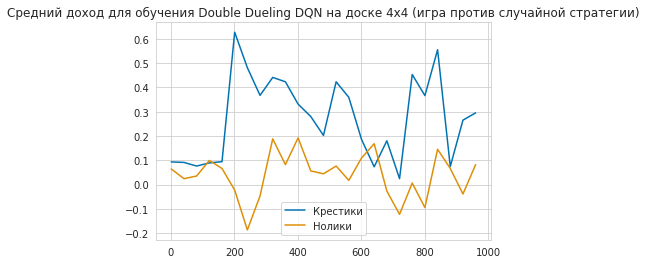

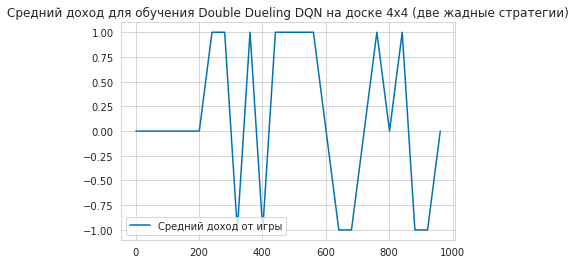

In [36]:
plot_nn_learning_double(
    double_dueling_dqn44, 
    n_episodes=1_000, 
    score_every=40, 
    algo='Double Dueling DQN'
)

#### Double Dueling $5x5$

In [39]:
torch.manual_seed(100500)
random.seed(100500)
np.random.seed(100500)


double_dueling_dqn55 = TicTacToeDoubleDuelingDQN(
    5, 5, 5, 
    eps_generator=eps_constant(0.65),
    batch_size=1024
)

### Здесь дождаться решения я так и не смог, по оценке tqdm время было огромным и ресурсов colab'a не хватает по времени. Поэтому пришлось отказаться от идеи обучать $5x5$

In [9]:
# plot_nn_learning_double(
#     double_dueling_dqn55, 
#     n_episodes=1_000, 
#     score_every=20, 
#     algo='Double Dueling DQN'
# )

## Часть третья: расширим и углубим поиск

Крестики-нолики -- это, конечно, далеко не го, и обычный альфа-бета поиск с отсечением здесь наверняка может работать идеально вплоть до довольно больших досок. Однако мы всё-таки для этого учебного задания будем реализовывать более практически релевантный метод MCTS -- заодно фактически получится и упражнение на многоруких бандитов.

### 5. Реализуйте rollouts со случайной стратегией и (опционально) rollouts с неслучайной, но простой стратегией (например, основанной на дополнении нескольких паттернов или на Q-функции, которая у вас получилась в первом пункте).

In [45]:
def single_rollout(
    env, 
    policy_naughts=policy_random(), 
    policy_crosses=policy_random(), 
    crosses=True
  ):
    env_copy = deepcopy(env)
    
    policies = [policy_naughts, policy_crosses]
    
    reward = 0
    while True:
        _, reward, done, _ = env_copy.step_int(
            policies[int(env_copy.curTurn > 0)](env_copy)
        )
        if done == True:
            break
            
    return reward if crosses == True else -reward

In [46]:
def policy_rollout(
    policy_crosses=policy_random(), 
    policy_naughts=policy_random(), 
    n_rollouts=10, 
    crosses=True
  ):
    def strategy(env):
        statistics = defaultdict(list)
        if len(env.getEmptyInts()) == 1:
            return env.getEmptyInts()[0]

        for action in env.getEmptyInts():
            for i in range(n_rollouts):
                env_copy = deepcopy(env)
                env_copy.step_int(action)
                statistics[action].append(
                    single_rollout(
                        env_copy, 
                        policy_crosses=policy_crosses, 
                        policy_naughts=policy_naughts, 
                        crosses=crosses
                    )
                )
                
        max_actions, max_reward = [], -np.inf
        for k, v in statistics.items():
            reward = np.mean(v)

            if np.allclose(reward, max_reward, rtol=0.0, atol=1e-5):
                max_actions.append(k)
            elif reward > max_reward:
                max_reward = reward
                max_actions = [k]

        return random.choice(max_actions)
    return strategy

#### Rollout'ы $3x3$

Возьмем политики из Q-learning

In [48]:
q33_policy_crosses = policy_q(Q_c_33)
q33_policy_naughts = policy_q(Q_n_33)

Возьмем политики из DQN

In [56]:
dqn33_policy_crosses = policy_nn(dqn33.model_crosses)
dqn33_policy_naughts = policy_nn(dqn33.model_naughts)

Обернем наши политики 

In [58]:
dqn33_policy_crosses_rollout_vs_random = policy_rollout(
    policy_crosses=dqn33_policy_crosses, 
    policy_naughts=policy_random(), 
    crosses=True
)

dqn33_policy_naughts_rollout_vs_random = policy_rollout(
    policy_crosses=policy_random(), 
    policy_naughts=dqn33_policy_naughts, 
    crosses=False
)

dqn33_policy_crosses_rollout_vs_q = policy_rollout(
    policy_crosses=dqn33_policy_crosses,
    policy_naughts=q33_policy_naughts, 
    crosses=True
)

dqn33_policy_naughts_rollout_vs_q = policy_rollout(
    policy_crosses=q33_policy_crosses, 
    policy_naughts=dqn33_policy_naughts, 
    crosses=False
)

dqn33_policy_crosses_rollout = policy_rollout(
    policy_crosses=dqn33_policy_crosses,
    policy_naughts=q33_policy_naughts, 
    crosses=True
)

dqn33_policy_naughts_rollout = policy_rollout(
    policy_crosses=q33_policy_crosses,
    policy_naughts=dqn33_policy_naughts,
    crosses=False
)

Сравним, какой прирост даст игра по политике крестиков с rollout'ами по сравнению с игрой без rollout'ов

In [59]:
calculate_reward_by_policies(
    dqn33_policy_crosses,
    dqn33_policy_naughts, 
    env=TicTacToe(3, 3, 3), 
    num_experiments=100
)[0]

  0%|          | 0/100 [00:00<?, ?it/s]

0.94

In [60]:
calculate_reward_by_policies(
    dqn33_policy_crosses_rollout_vs_q,
    dqn33_policy_naughts, 
    env=TicTacToe(3, 3, 3), 
    num_experiments=100
)[0]

  0%|          | 0/100 [00:00<?, ?it/s]

0.91

Сравним, какой прирост дает игра политика ноликов с rollout vs игра без rollout'ов

In [61]:
calculate_reward_by_policies(
    dqn33_policy_crosses, 
    dqn33_policy_naughts, 
    env=TicTacToe(3, 3, 3), 
    num_experiments=100
)[0]

  0%|          | 0/100 [00:00<?, ?it/s]

0.82

In [62]:
calculate_reward_by_policies(
    dqn33_policy_crosses, 
    dqn33_policy_naughts_rollout_vs_q, 
    env=TicTacToe(3, 3, 3), 
    num_experiments=1000
)[0]

  0%|          | 0/1000 [00:00<?, ?it/s]

-0.497

Сравним прирост игры со случайными политиками vs попытки улучшить эти стратегии

In [63]:
calculate_reward_by_policies(
    policy_random(),
    policy_random(),
    env=TicTacToe(3, 3, 3),
    num_experiments=100
)[0]

  0%|          | 0/100 [00:00<?, ?it/s]

0.4

In [64]:
calculate_reward_by_policies(
    policy_rollout(policy_random(), policy_random(), n_rollouts=10, crosses=True),
    policy_random(),
    env=TicTacToe(3, 3, 3),
    num_experiments=100
)[0]

  0%|          | 0/100 [00:00<?, ?it/s]

0.86

In [65]:
calculate_reward_by_policies(
    policy_random(),
    policy_rollout(policy_random(), policy_random(), n_rollouts=10, crosses=False),
    env=TicTacToe(3, 3, 3),
    num_experiments=100
)[0]

  0%|          | 0/100 [00:00<?, ?it/s]

-0.47

* Рассуждения что может быть дальше - повышает наши шансы выиграть в случае игры и за крестики и за нолики, когда мы начинаем с нуля (со случайных стратегий).
* Попытки улучшить уже обученные DQN стратегии дают не большой прирост. 
* Предполагаю, что в данном случае стратегии для игры 3x3 уже сошлись и данная идея плохо работает  со стратегией, отличной от стратегии противника

### 6. Реализуйте MCTS-поиск с этими rollouts для крестиков-ноликов на досках разного размера, сравните полученные стратегии между собой и со стратегиями, обученными в первых двух частях.

* Постарался строить дерево по нескольким уровням:
  * уровни, в которых записаны состояния - StateNode, 
  * внутри StateNode есть несколько ActionNode - возможные действия.
* В рамках одного состояния может быть несколько действий.
* Состояние само по себе зависит от какого-то действия (от того, которое привело нас сюда). 
* В одно состояние нас могли привести несколько действий, это нужно как-то обрабатывать.


In [66]:
class ActionNode:
    def __init__(self, parent_state=None):
        self.parent_state = parent_state
        self.states = {}
        self.reward = 0
        self.n_visits = 0
        
    @property
    def uct(self):
        if self.n_visits == 0:
            return np.inf
        slag1 = self.reward / self.n_visits
        slag2 = 1.0 * np.sqrt(np.log(self.parent_state.n_visits) / self.n_visits)
        return slag1 + slag2

class StateNode:
    def __init__(
        self, 
        parent_actions=[], 
        state=None,
        available_actions=None
    ):
        self.parent_actions = parent_actions
        self.state = state
        self.actions = { x: ActionNode(self) for x in available_actions }

    @property
    def n_visits(self):
        return sum([x.n_visits for x in self.actions.values()])

    @property
    def reward(self):
        return sum([x.reward for x in self.actions.values()])
    

class MCTS:

    def __init__(
        self, 
        policy_crosses=policy_random(), 
        policy_naughts=policy_random(), 
        crosses=True
    ):
        self.state_nodes = {}
        self.policy_crosses = policy_crosses
        self.policy_naughts = policy_naughts
        # Строим ли мы дерево для крестиков
        self.crosses = crosses

    def backup(self, action_node, reward, n_action_simulations):
        action_nodes = [action_node]
        
        while len(action_nodes) > 0:
            new_action_nodes = []

            for action_node in action_nodes:
                action_node.reward += reward
                action_node.n_visits += n_action_simulations
                new_action_nodes.extend(
                    list(
                        filter(
                            lambda x: x is not None, action_node.parent_state.parent_actions
                        )
                    )
                )
                
            action_nodes = new_action_nodes
        
    def add_state(self, env, prev_state=None, prev_action=None):
        if env.getState()[0] not in self.state_nodes:
            if (prev_state != None) and (prev_action != None):
                state = StateNode(
                    parent_actions=[
                                    self.state_nodes[prev_state] \
                                        .actions[prev_action]
                    ],
                    state=env.getState()[0],
                    available_actions=env.getEmptyInts()
                )
                self.state_nodes[prev_state] \
                    .actions[prev_action] \
                    .states[env.getState()[0]] = state
            else:
                state = StateNode(
                    parent_actions=[None], 
                    state=env.getState()[0], 
                    available_actions=env.getEmptyInts()
                )
            self.state_nodes[env.getState()[0]] = state
        else:
            state = self.state_nodes[env.getState()[0]]
            if (prev_state != None):
                previous_action = self.state_nodes[prev_state].actions[prev_action]
                if previous_action not in state.parent_actions:
                    state.parent_actions.append(previous_action)
        return state

    def selection_expansion(self, env):
        state = env.getState()[0]

        # Ищем потомка, которого мы будем раскрывать
        while True:
            zero_actions = []
            for action, action_node in self.state_nodes[state].actions.items():
                if action_node.n_visits == 0:
                    zero_actions.append(action)
            if len(zero_actions) > 0:
                #return env, [random.choice(zero_actions)]
                return env, zero_actions
                
            max_actions, max_uct = [], -np.inf
            for action, action_node in self.state_nodes[state].actions.items():
                # Подсчитаем UCT
                uct = action_node.uct
                # Найдем несколько максимумумов
                if np.allclose(uct, max_uct, rtol=0.0, atol=1e-5):
                    max_actions.append(action)
                elif uct > max_uct:
                    max_uct = uct
                    max_actions = [action]

            if len(max_actions) > 0:
                action = random.choice(max_actions)
            else:
                return env, []
            
            if len(env.getEmptyInts()) == 1:
                return env, [action]
            
            env.step_int(action)
            if self.crosses == True:
                env.step_int(self.policy_naughts(env))
            else:
                env.step_int(self.policy_crosses(env))
            self.add_state(env, prev_state=state, prev_action=action)
            state = env.getState()[0]
    
    def __call__(
        self, 
        env, 
        prev_state=None, 
        prev_action=None, 
        n_action_simulations=100
    ):
        state = self.add_state(env, prev_state=prev_state, prev_action=prev_action)
        env_copy = deepcopy(env)
        env_copy, actions = self.selection_expansion(env_copy)

        for action in actions:
            env_copy_copy = deepcopy(env_copy)
            _, reward, done, _ = env_copy_copy.step_int(action)
            if not done:
                reward = sum([
                              single_rollout(
                                  env_copy_copy, 
                                  policy_crosses=self.policy_crosses, 
                                  policy_naughts=self.policy_naughts, 
                                  crosses=self.crosses
                              ) for _ in range(n_action_simulations)])
            action_node = self.state_nodes[env_copy.getState()[0]].actions[action]
            self.backup(action_node, reward, n_action_simulations)
        
        max_actions, max_gain = [], -np.inf
        for action, action_node in state.actions.items():
            if action_node.n_visits == 0:
                continue
            gain = action_node.reward / action_node.n_visits
            if np.allclose(gain, max_gain, rtol=0.0, atol=1e-5):
                max_actions.append(action)
            elif gain > max_gain:
                max_gain = gain
                max_actions = [action]
        return random.choice(max_actions)
            
        
    

Опишем функцию, которая улучшает имеющуюся политику по MCTS

In [67]:
def policy_mcts(
    policy_crosses=policy_random(), 
    policy_naughts=policy_random(), 
    n_rollouts=10, crosses=True
  ):
    mcts = MCTS(
        policy_crosses=policy_crosses,
        policy_naughts=policy_naughts, 
        crosses=crosses
    )
    def strategy(env):
        if crosses == True:
            prev_state, prev_action = env.prev_crosses_state, env.prev_crosses_action
        else:
            prev_state, prev_action = env.prev_naughts_state, env.prev_naughts_action
        action = mcts(
            env, 
            prev_state=prev_state,
            prev_action=prev_action, 
            n_action_simulations=n_rollouts
        )
        return action
    return strategy

In [69]:
dqn33_policy_crosses_mcts_vs_q = policy_mcts(
    policy_crosses=dqn33_policy_crosses, 
    policy_naughts=q33_policy_naughts, 
    crosses=True, 
    n_rollouts=100
)

dqn33_policy_naughts_mcts_vs_q = policy_mcts(
    policy_crosses=q33_policy_crosses, 
    policy_naughts=dqn33_policy_naughts, 
    crosses=False, 
    n_rollouts=100
)

Посмотрим, насколько применение MCTS улучшит игру, если мы играем случайно

In [70]:
calculate_reward_by_policies(
    policy_random(),
    policy_random(),
    env=TicTacToe(3, 3, 3),
    num_experiments=1_000
)[0]

  0%|          | 0/1000 [00:00<?, ?it/s]

0.285

In [71]:
calculate_reward_by_policies(
    policy_mcts(policy_random(), policy_random(), n_rollouts=10, crosses=True),
    policy_random(),
    env=TicTacToe(3, 3, 3),
    num_experiments=1_000
)[0]

  0%|          | 0/1000 [00:00<?, ?it/s]

0.733

In [72]:
calculate_reward_by_policies(
    policy_random(),
    policy_mcts(policy_random(), policy_random(), n_rollouts=10, crosses=False),
    env=TicTacToe(3, 3, 3),
    num_experiments=1_000
)[0]

  0%|          | 0/1000 [00:00<?, ?it/s]

-0.34